## $k_x$ study 

In [10]:
# Librerías estándar y de terceros
import os
import sys
import gc
import math as m
import numpy as np
import scipy
import pandas as pd
from scipy import *
from scipy.signal import butter, filtfilt, hilbert
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pylab
from matplotlib import pyplot as plt
import pylab 
params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (15, 6),
         'axes.labelsize': 33,
         'axes.titlesize':33,
         'xtick.labelsize':30,
         'ytick.labelsize':30,
    'font.family': 'STIXGeneral',  # Use 'Comic Sans MS' or 'Helvetica' here as needed
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True, # Enable LaTeX rendering
}

pylab.rcParams.update(params)

# Configuración de rutas para importaciones personalizadas
#sys.path.append('/projects/DEIKE/cmartinb/jupyter_notebook/project_specific/turbulence')
sys.path.append('/projects/DEIKE/cmartinb/functions')
# Funciones y clases personalizadas
from prepare import load_object, save_object, field
from defs import Case, Interface2D
from phase import extract_phase
from funciones import *  # Asegúrate de que la importación con * sea necesaria, a veces es mejor importar solo las funciones necesarias

os.chdir('/projects/DEIKE/cmartinb/')

In [265]:
work_dir = '/projects/DEIKE/nscapin/broadband/kpHs0p16_uoc0p50/'
data = np.loadtxt(work_dir+'eta/global_int.out')

# Obtener la segunda columna
istep_c =data[:, 1]
time = data[:,0] 

In [266]:
L0 = 2*np.pi; N = 512;
tstart = time[0]
kp = 4; omegap = (1*kp)**0.5

In [267]:
eta_series = np.load('eta/eta_series_kpHs0p16_uoc0p50.npy', allow_pickle=True)
print(eta_series.shape)

(473, 512, 512)


In [268]:
tstart = time[0]
indice = np.argmax(omegap*(time - tstart) > 10)
print(indice)

# Selecciona los valores de eta_series desde ese índice en adelante
eta_series_trimmed = eta_series[indice:, :]
# Puedes verificar la forma de los datos recortados si quieres
print(eta_series_trimmed.shape)
time = time[indice:]
tstart = time[0]
eta_series = eta_series_trimmed
print((time - tstart)*omegap)

51
(422, 512, 512)
[ 0.         0.1963496  0.392699   0.5890486  0.7853982  0.9817476
  1.1780972  1.3744468  1.5707964  1.7671458  1.9634954  2.159845
  2.3561944  2.552544   2.7488936  2.945243   3.1415926  3.3379422
  3.5342918  3.7306412  3.9269908  4.1233404  4.3196898  4.5160394
  4.712389   4.9087386  5.105088   5.3014376  5.4977872  5.6941366
  5.8904862  6.0868358  6.2831852  6.4795348  6.6758844  6.872234
  7.0685834  7.264933   7.4612826  7.657632   7.8539816  8.0503312
  8.2466806  8.4430302  8.6393798  8.8357294  9.0320788  9.2284284
  9.424778   9.6211274  9.817477  10.0138266 10.2101762 10.4065256
 10.6028752 10.7992248 10.9955742 11.1919238 11.3882734 11.5846228
 11.7809724 11.977322  12.1736716 12.370021  12.5663706 12.7627202
 12.9590696 13.1554192 13.3517688 13.5481184 13.7444678 13.9408174
 14.137167  14.3335164 14.529866  14.7262156 14.922565  15.1189146
 15.3152642 15.5116138 15.7079632 15.9043128 16.1006624 16.2970118
 16.4933614 16.689711  16.8860604 17.08241   

In [263]:
def spectrum_integration(eta, N,L,CHECK=False):
    """ This function performs azimuthal integration of the 2D spectrum (Notice it's 2D instead of 3D with the frequency as well).
        When in doubt, enable CHECK so that the integration is printed out at each step to make sure that 
        units are consistent and we always recover the variance of the data. """  
    #print('N=%g' %N + ', L=%g' %L)
    varr =  np.var(eta)
    
    if CHECK: print('var', np.var(eta))
    
    variance.append(varr)
    if CHECK:print('mean', np.mean(eta))
    
    T0 = 2*np.pi # L0/k = 2pi/4pi
    deltaf = 1/ 2*np.pi
    wavenumber = 2*np.pi*np.fft.fftfreq(N,L/N)
    kx = np.fft.fftshift(wavenumber); ky = kx
    kx_tile, ky_tile = np.meshgrid(kx,ky)
    theta = 2*np.pi*np.arange(-N/2,N/2)/(N)
    
    k = wavenumber[0:int(N/2)]
    dkx = kx[1] - kx[0]; dky = ky[1] - ky[0]
    dk = k[1]-k[0]; dtheta = theta[1]-theta[0]
    dkx = kx[1]-kx[0]; dky = ky[1]-ky[0]
    
    spectrum = np.fft.fft2(eta)/(N*N)**0.5  # FFT normalization 
    F = np.absolute(spectrum)**2/N**2/(dkx*dky) # Per area normalization
    
    if CHECK: print ('sum F', np.sum(F))
    F_center = np.fft.fftshift(F,axes=(0,1)) # Further normalization by independent variables
    
    k_tile, theta_tile = np.meshgrid(k,theta)
    kxp_tile, kyp_tile = pol2cart(k_tile, theta_tile)
    
    integ = np.sum(F_center)*dkx*dky
    if CHECK:print('integral',np.sum(F_center)*dkx*dky)
    
    integral.append(integ)
    
    F_center_polar = scipy.interpolate.griddata((kx_tile.ravel(),ky_tile.ravel()), F_center.ravel(), (kxp_tile, kyp_tile), method='nearest', fill_value=0)
    F_center_polar_integrated = np.sum(F_center_polar*k_tile, axis=0)*dtheta # Azimuthal integration
    
    int_pol = np.sum(F_center_polar_integrated)*dk
    if CHECK: print ('sum polar integrated', np.sum(F_center_polar_integrated)*dk)
    
    polar_integral.append(int_pol)
    
    return k, F_center, F_center_polar_integrated , F_center_polar , k_tile, kxp_tile, kyp_tile , theta_tile , theta , variance, integral, polar_integral , kx, ky



/tmp/ipykernel_1165746/1223153496.py:95: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim([0,10])


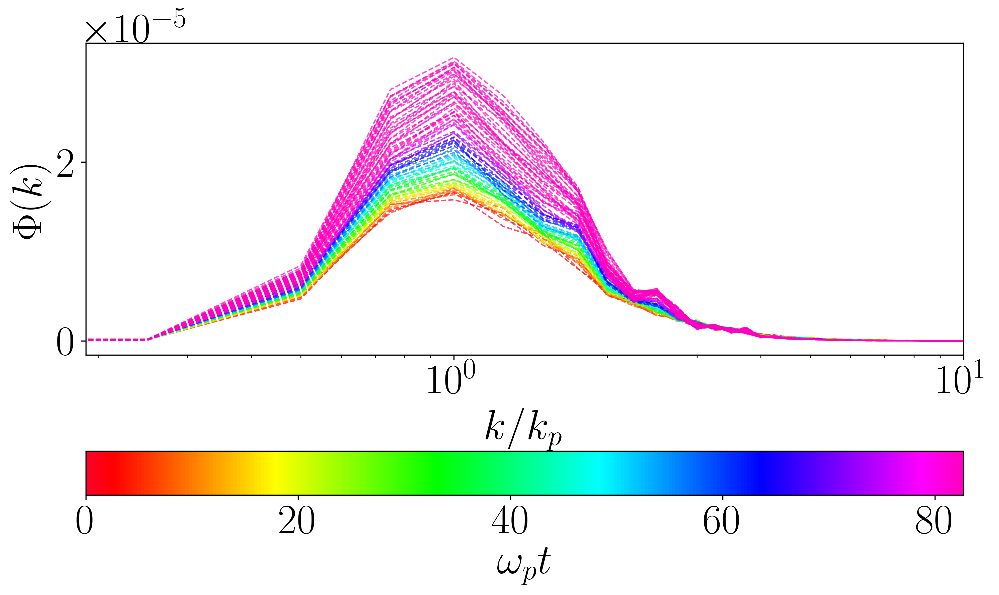

In [308]:
import matplotlib.cm as cm
from scipy.interpolate import interp1d
color_map = plt.cm.gist_rainbow
fig = plt.figure(figsize=[10, 6])
ax = fig.gca()

num_rows = 2
num_cols = 3

kp = 4

N = 512
L = 2 * np.pi

j = 0

variance = []
integral = []
polar_integral = []

# modes growth
energy_mode = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode =[]
pylab.rcParams.update(params)

filtered_coordx_mode = []
filtered_energy_mode = []

for i in range(len(eta_series)):
    eta = eta_series[i]
    #print(i, variance)
    k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, varr, integ, int_pol , kx, ky = spectrum_integration(eta - np.mean(eta), N, L, CHECK=False)
    #print('k', k, 'kx', kx[int(len(kx)/2):])
    #k = kx[int(len(kx)/2):]
    dk = k[1] - k[0]
    
    #print(k)
    if i == 0:

        indices1 = np.arange(0, np.where(k >= 1)[0][0], max(1, int(0.25 / dk)))
        indices10 = np.arange(np.where(k >= 1)[0][0], np.where(k >= 10)[0][0], max(1, int(1 / dk)))
        indices1020 = np.arange(np.where(k >= 10)[0][0], np.where(k > 40)[0][0], max(1, int(1 / dk)))
        indices100 = np.arange(np.where(k >= 20)[0][0], np.where(k > 100)[0][0], max(1, int(10/ dk)))
        indicesplus = np.arange(np.where(k >= 100)[0][0], len(k), max(1, int(20 / dk)))

        k_multiples = np.concatenate((indices1, indices10, indices1020 ,indices100, indicesplus))

        k_multiples = k_multiples.astype(int)
        # Obtener los valores de k y las energías correspondientes
        k_seleccionados = k[k_multiples]

    energias_correspondientes = F_center_polar_integrated[k_multiples]
    #k = k/4
    
    if i == 0:
        E0_both = np.sum(F_center_polar_integrated) * dk
        #print(type(indices_cada_diez))
        E0_nodes_both = F_center_polar_integrated[k_multiples]
        #E0_second_both =  F_center_polar_integrated[k_second]
    
    if i % 5 == 0:
        psd = ax.plot(k/4, F_center_polar_integrated, '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=1)
    
    energy_mode.append(energias_correspondientes.tolist())
    #coordx_mode.append(coordx.tolist())
    integral.append(integ)
    variance.append(varr)
    polar_integral.append(int_pol)
 
    j += 1


color_values =  (omegap*(np.array(time)-time[0]))

# Now set the normalization with the correct range

norm = plt.Normalize(vmin=color_values.min(), vmax=color_values.max())
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])  

# Add the colorbar to the figure
cbar = plt.colorbar(sm, orientation='horizontal', pad=0.2)

# Set colorbar label and other properties if needed
cbar.set_label('$\omega_{p} t$')


fig.tight_layout()
cbar.set_label('$\omega_{p} t$')
plt.xscale('log')
plt.xlim([0,10])
#plt.ylim([0*10**(-8), 2.5*10**(-8)])
#plt.yscale('log')
plt.xlabel('$\mathdefault{k/k_{p}}$')
plt.ylabel('$\mathdefault{\Phi(k)}$')
fig.tight_layout()

(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)
(512, 512)

/tmp/ipykernel_1165746/2784826553.py:118: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim([0,10])


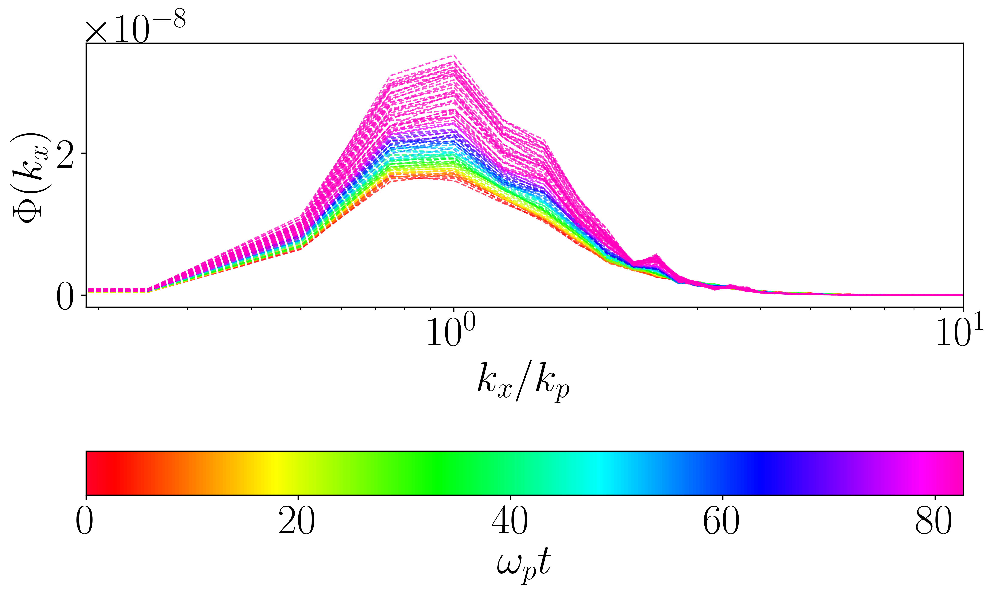

In [311]:
color_map = plt.cm.gist_rainbow
fig = plt.figure(figsize=[10, 6])
ax = fig.gca()

params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (15, 8),
         'axes.labelsize': 30,
         'axes.titlesize':31,
         'xtick.labelsize':30,
         'ytick.labelsize':30,
    'font.family': 'STIXGeneral',  # Use 'Comic Sans MS' or 'Helvetica' here as needed
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True, # Enable LaTeX rendering
}



pylab.rcParams.update(params)


num_rows = 2
num_cols = 3

kp = 4

N = 512
L = 2 * np.pi

j = 0

variance = []
integral = []
polar_integral = []

# modes growth
energy_mode = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode =[]
pylab.rcParams.update(params)

filtered_coordx_mode = []
filtered_energy_mode = []

for i in range(len(eta_series)):
    eta = eta_series[i]
    #print(i, variance)
    #im = ax.contourf(kx, ky, np.log(F_center/np.max(F_center)), extend='both', levels=levels)
    
    k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, varr, integ, int_pol , kx, ky = spectrum_integration(
        eta - np.mean(eta), N, L, CHECK=False)
    
    print(F_center.shape)
    
    F_center = np.mean(F_center, axis = 0)
    
    k = kx[int(len(kx)/2):]
    F_center_polar_integrated =F_center[int(len(F_center)/2):]
    dk = k[1] - k[0]
    
    #print(k)
    if i == 0:

        indices1 = np.arange(0, np.where(k >= 1)[0][0], max(1, int(0.25 / dk)))
        indices10 = np.arange(np.where(k >= 1)[0][0], np.where(k >= 10)[0][0], max(1, int(1 / dk)))
        indices1020 = np.arange(np.where(k >= 10)[0][0], np.where(k > 40)[0][0], max(1, int(1 / dk)))
        indices100 = np.arange(np.where(k >= 20)[0][0], np.where(k > 100)[0][0], max(1, int(10/ dk)))
        indicesplus = np.arange(np.where(k >= 100)[0][0], len(k), max(1, int(20 / dk)))

        k_multiples = np.concatenate((indices1, indices10, indices1020 ,indices100, indicesplus))

        k_multiples = k_multiples.astype(int)
        # Obtener los valores de k y las energías correspondientes
        k_seleccionados = kx[k_multiples]

    energias_correspondientes = F_center[k_multiples]
    #k = k/4
    
    if i == 0:
        E0_both = np.sum(F_center_polar_integrated) * dk
        #print(type(indices_cada_diez))
        E0_nodes_both = F_center_polar_integrated[k_multiples]
        #E0_second_both =  F_center_polar_integrated[k_second]
    
    if i % 5 == 0:
        psd = ax.plot(kx/4, F_center, '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=1)
    
    energy_mode.append(energias_correspondientes.tolist())
    #coordx_mode.append(coordx.tolist())
    integral.append(integ)
    variance.append(varr)
    polar_integral.append(int_pol)
 
    j += 1


color_values =  (omegap*(np.array(time)-time[0]))

# Now set the normalization with the correct range

norm = plt.Normalize(vmin=color_values.min(), vmax=color_values.max())
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])  

# Add the colorbar to the figure
cbar = plt.colorbar(sm, orientation='horizontal', pad=0.3)

# Set colorbar label and other properties if needed
cbar.set_label('$\omega_{p} t$')


fig.tight_layout()
cbar.set_label('$\omega_{p} t$')
plt.xscale('log')
plt.xlim([0,10])
#plt.ylim([10**-12,10**-3])
#plt.yscale('log')
plt.xlabel('$\mathdefault{k_x/k_{p}}$')
plt.ylabel('$\mathdefault{\Phi(k_x)}$')
fig.tight_layout()

/tmp/ipykernel_1165746/1912272175.py:117: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim([0,10])


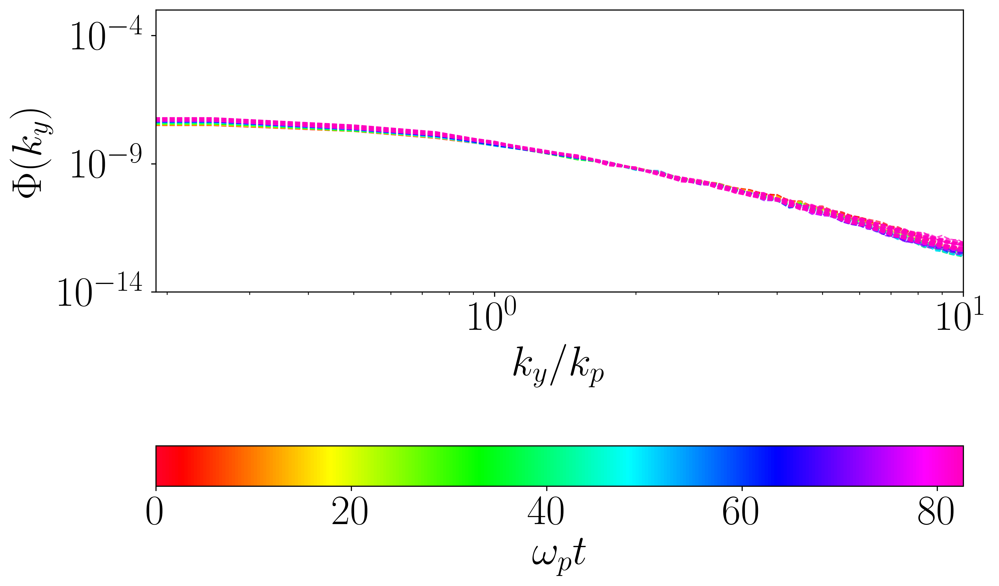

In [271]:
color_map = plt.cm.gist_rainbow
fig = plt.figure(figsize=[10, 6])
ax = fig.gca()

params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (15, 8),
         'axes.labelsize': 30,
         'axes.titlesize':31,
         'xtick.labelsize':30,
         'ytick.labelsize':30,
    'font.family': 'STIXGeneral',  # Use 'Comic Sans MS' or 'Helvetica' here as needed
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True, # Enable LaTeX rendering
}



pylab.rcParams.update(params)


num_rows = 2
num_cols = 3

kp = 4

N = 512
L = 2 * np.pi

j = 0

variance = []
integral = []
polar_integral = []

# modes growth
energy_mode = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode =[]
pylab.rcParams.update(params)

filtered_coordx_mode = []
filtered_energy_mode = []

for i in range(len(eta_series)):
    eta = eta_series[i]
    #print(i, variance)
    #im = ax.contourf(kx, ky, np.log(F_center/np.max(F_center)), extend='both', levels=levels)
    
    k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, varr, integ, int_pol , kx, ky = spectrum_integration(eta - np.mean(eta), N, L, CHECK=False)
    
    #print(F_center.shape)
    
    F_center = np.mean(F_center, axis = 1)
    
    k = ky[int(len(kx)/2):]
    F_center_polar_integrated =F_center[int(len(F_center)/2):]
    dk = k[1] - k[0]
    
    #print(k)
    if i == 0:

        indices1 = np.arange(0, np.where(k >= 1)[0][0], max(1, int(0.25 / dk)))
        indices10 = np.arange(np.where(k >= 1)[0][0], np.where(k >= 10)[0][0], max(1, int(1 / dk)))
        indices1020 = np.arange(np.where(k >= 10)[0][0], np.where(k > 40)[0][0], max(1, int(1 / dk)))
        indices100 = np.arange(np.where(k >= 20)[0][0], np.where(k > 100)[0][0], max(1, int(10/ dk)))
        indicesplus = np.arange(np.where(k >= 100)[0][0], len(k), max(1, int(20 / dk)))

        k_multiples = np.concatenate((indices1, indices10, indices1020 ,indices100, indicesplus))

        k_multiples = k_multiples.astype(int)
        # Obtener los valores de k y las energías correspondientes
        k_seleccionados = ky[k_multiples]

    energias_correspondientes = F_center[k_multiples]
    #k = k/4
    
    if i == 0:
        E0_both = np.sum(F_center_polar_integrated) * dk
        #print(type(indices_cada_diez))
        E0_nodes_both = F_center_polar_integrated[k_multiples]
        #E0_second_both =  F_center_polar_integrated[k_second]
    
    if i % 5 == 0:
        psd = ax.plot(ky/4, F_center, '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=1)
    
    energy_mode.append(energias_correspondientes.tolist())
    #coordx_mode.append(coordx.tolist())
    integral.append(integ)
    variance.append(varr)
    polar_integral.append(int_pol)
 
    j += 1


color_values =  (omegap*(np.array(time)-time[0]))

# Now set the normalization with the correct range

norm = plt.Normalize(vmin=color_values.min(), vmax=color_values.max())
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])  

# Add the colorbar to the figure
cbar = plt.colorbar(sm, orientation='horizontal', pad=0.3)

# Set colorbar label and other properties if needed
cbar.set_label('$\omega_{p} t$')


fig.tight_layout()
cbar.set_label('$\omega_{p} t$')
plt.xscale('log')
plt.xlim([0,10])
plt.ylim([10**-14,10**-3])
plt.yscale('log')
plt.xlabel('$\mathdefault{k_y/k_{p}}$')
plt.ylabel('$\mathdefault{\Phi(k_y)}$')
fig.tight_layout()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
from scipy.interpolate import interp1d
from scipy import integrate
import csv
import pylab

color_map = plt.cm.gist_rainbow
fig = plt.figure(figsize=[10, 6])
ax = fig.gca()

params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (15, 8),
         'axes.labelsize': 30,
         'axes.titlesize': 31,
         'xtick.labelsize': 30,
         'ytick.labelsize': 30,
         'font.family': 'STIXGeneral',  # Use 'Comic Sans MS' or 'Helvetica' here as needed
         'axes.titleweight': 'normal',
         'axes.labelweight': 'normal',
         'text.usetex': True, # Enable LaTeX rendering
}

pylab.rcParams.update(params)

N = 512
L = 2 * np.pi

j = 0

variance = []
integral = []
polar_integral = []

k_seleccionados = []

# modes growth
energy_interval_time = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode = []

F_mode = []
filtered_coordx_mode = []
filtered_energy_mode = []

with open('kpHs016_upc05_energieskx.csv', 'w', newline='') as file:
    writer = csv.writer(file)

    for i in range(len(eta_series)):
        eta = eta_series[i]
        k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, varr, integ, int_pol, kx, ky = spectrum_integration(
            eta - np.mean(eta), N, L, CHECK=False)

        E_interval = []

        F_center = np.mean(F_center, axis=0)

        kx = kx[int(len(kx)/2):]
        dk = kx[1] - kx[0]

        for m in range(41):
            if m == 0:
                idx_start, idx_end = 0, 1
            elif m == len(kx) - 1:
                idx_start, idx_end = m - 1, m
            else:
                idx_start, idx_end = m - 1, m + 1

            F_integral_interval = integrate.trapezoid(F_center[int(len(F_center)/2):][idx_start:idx_end+1], kx[idx_start:idx_end+1])

            k_seleccionados.append(kx[m])
            E_interval.append(F_integral_interval)
            writer.writerow([i, m, F_integral_interval, omegap*(time[i]-time[0])])

        energy_interval_time.append(E_interval)

        sm = ax.plot(kx/4, F_center[int(len(F_center)/2):], '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=0.3)

        j += 1

#for km in k_seleccionados:
   #ax.axvline(x=km/4, color='gray', linestyle='--', linewidth=0.3)

ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))

color_values = (omegap*(np.array(time)-time[0]))

norm = plt.Normalize(vmin=color_values.min(), vmax=color_values.max())
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, orientation='horizontal', pad=0.2)
cbar.set_label('$\omega_{p} t$')

fig.tight_layout()
cbar.set_label('$\omega_{p} t$')
plt.xscale('log')
plt.xlim([0, 10])
#plt.ylim([10**(-12), 10**(-3)])
#plt.yscale('log')
plt.xlabel('$\mathdefault{k_x/k_{p}}$')
plt.ylabel('$\mathdefault{\Phi(k_x)}$')
fig.tight_layout()
plt.show()


In [273]:
df = pd.read_csv('kpHs016_upc05_energieskx.csv', names=['i', 'kx', 'F_integral_interval', 'time'])

In [274]:
print(df['i'], df['F_integral_interval'])

0          0
1          0
2          0
3          0
4          0
        ... 
17297    421
17298    421
17299    421
17300    421
17301    421
Name: i, Length: 17302, dtype: int64 0        2.234155e-10
1        3.645892e-09
2        1.503374e-08
3        2.806782e-08
4        3.098421e-08
             ...     
17297    1.854642e-11
17298    1.740374e-11
17299    1.543087e-11
17300    1.432285e-11
17301    1.289651e-11
Name: F_integral_interval, Length: 17302, dtype: float64


In [275]:
# Crear una columna de grupo para cada 'i' que indique el número de intervalo
df['interval_num'] = df.groupby('i').cumcount()

# Ahora pivotar el DataFrame para que cada fila sea una 'i' y cada columna un intervalo
df_pivot = df.pivot(index='i', columns='interval_num', values='F_integral_interval')

# Si deseas que el DataFrame resultante tenga únicamente los valores de integración sin los índices de intervalos como nombres de columnas
df_pivot.columns = [f'interval_{i}' for i in range(len(df_pivot.columns))]

# Resetea el índice para que 'i' sea una columna normal en lugar de un índice
df_pivot = df_pivot.reset_index()

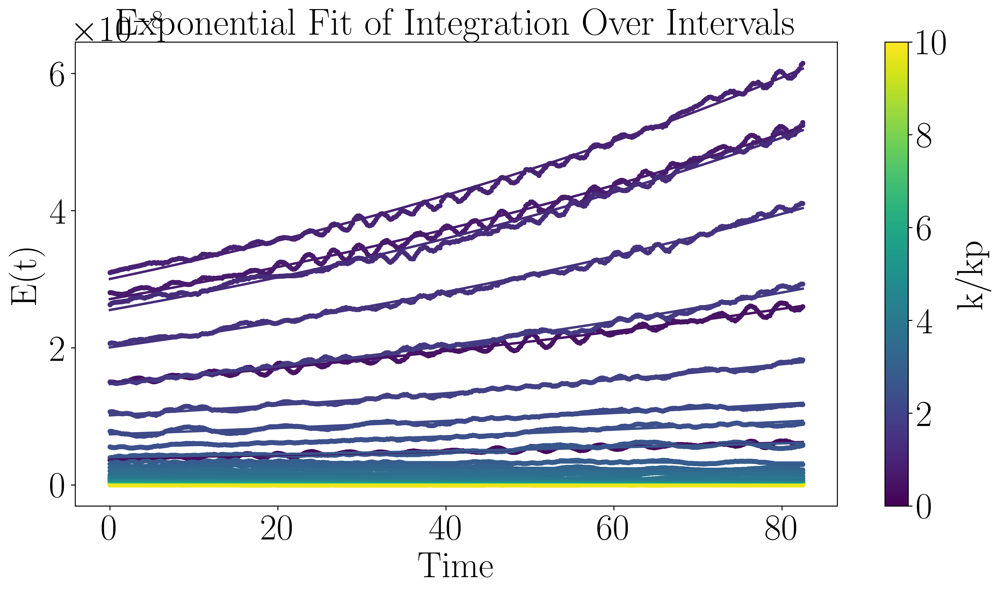

Growth betas: [0.0073713121968781645, 0.005800804502883431, 0.006846391324722461, 0.007961902297588011, 0.00852995470546128, 0.008569977621738814, 0.008479907323855425, 0.008075053504811516, 0.006882826562563538, 0.00585735790873151, 0.006523033706041469, 0.005060086387909099]
Decay betas: [-0.000373403792716261, -0.002852059576684176, -0.0013965481094721616, -0.0001398329732268926, -0.003349034855429691, -0.006472863820667289, -0.006880380037962846, -0.008963413134295654, -0.010435054600097148, -0.009996511328172208, -0.009867076529975618, -0.010451991843804574, -0.010385019981501308, -0.009115584155488984, -0.00971393689744551, -0.012138740216715198, -0.010798655918077802, -0.00854639350656455, -0.009222319067487626, -0.009235853077996656, -0.007524269230875573, -0.006449353133869674, -0.005853297420853919, -0.004250975843827218, -0.00328341033215259, -0.003928434303733393, -0.0032842826882250424, -0.0010076254106210646, -0.00022609792455277418]
Growth k: [0, 1, 2, 3, 4, 5, 6, 7, 8, 

In [276]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.optimize import curve_fit

# Asumiendo que 'df_pivot' es tu DataFrame y que 'time' y 'k_seleccionados' están definidos
colormap = cm.viridis
normalize = plt.Normalize(vmin=0, vmax=(len(df_pivot.columns) - 2)/4)  # normalizar basado en el número de intervalos

# Crear una figura y un eje para el ploteo
fig, ax = plt.subplots(figsize=(14, 7))

# Definir la función del modelo exponencial
def exp_model(x, a, b):
    return a * np.exp(b * x)

# Crear listas para almacenar los parámetros de crecimiento y decadencia
beta_growth = []
beta_decay = []

k_growth = []
k_decay = []

# Iterar sobre cada intervalo y realizar ajuste exponencial
for idx, column in enumerate(df_pivot.columns[1:]):  # Ignora la primera columna que es 'i'
    # Extraer datos para el intervalo actual
    mode_total_norm = df_pivot[column].dropna()  # Eliminar valores NaN por seguridad
    tiempo_valido = omegap*(time[:len(mode_total_norm)-1]-tstart)  # Asegurar que tiempo y mode_total_norm tengan la misma longitud
    
    mode_total_norm = mode_total_norm[:-1]
    
    # Ajuste exponencial solo si todos los valores son positivos y hay suficientes datos
    if len(mode_total_norm) > 1 and np.all(mode_total_norm > 0):
        popt, pcov = curve_fit(exp_model, tiempo_valido, mode_total_norm, p0=(1, 0.001), maxfev=100000)
        a, b = popt
        if b > 0:
            beta_growth.append(b)
            k_growth.append(idx)
        else:
            beta_decay.append(b)
            k_decay.append(idx)
        
        # Realizar gráfico para cada intervalo
        color = cm.viridis(idx / len(df_pivot.columns[1:]))  # Normalizar color
        ax.scatter(tiempo_valido, mode_total_norm, color=color, s=10)
        ax.plot(tiempo_valido, exp_model(tiempo_valido, *popt), color=color, lw=2)

# Configurar gráfico
ax.set_xlabel('Time')
ax.set_ylabel('E(t)')
ax.set_title('Exponential Fit of Integration Over Intervals')
plt.colorbar(cm.ScalarMappable(norm=normalize, cmap=colormap), label='k/kp')
#plt.legend()
plt.show()

# Imprimir los valores de beta para crecimiento y decadencia
print("Growth betas:", beta_growth)
print("Decay betas:", beta_decay)
print("Growth k:", k_growth)
print("Decay k:", k_decay)

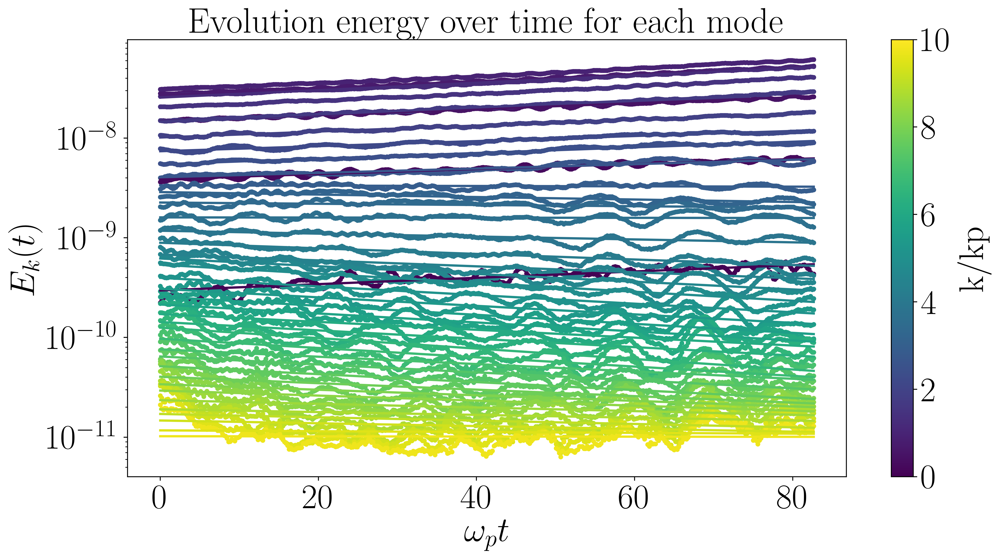

Growth betas: [0.007321740990876909, 0.005787203464449435, 0.00684553391578892, 0.007965355087604776, 0.008533315553350016, 0.008571918627572662, 0.008482598552206642, 0.008080647268036775, 0.006887161459090362, 0.005852637310480738, 0.0065142448591148155, 0.005049086139370449]
Decay betas: [-0.0003851831865047348, -0.002858279123431198, -0.0014188819884713687, -0.00017253932372700154, -0.0033490376951567065, -0.006455671640317782, -0.006869419584898412, -0.008940906238658826, -0.01040029791102184, -0.009953412264095593, -0.009825918331193924, -0.010426243414392345, -0.010377562849706987, -0.009095545595440806, -0.009669673897609941, -0.01208503413643856, -0.010736913262385015, -0.008493948206784094, -0.009177812552937101, -0.009172858788410666, -0.007465397084410912, -0.006414795780287932, -0.005816357653150806, -0.00421289196556026, -0.0032346861678939757, -0.003857441788413753, -0.0032162217826914464, -0.0009416155507630894, -0.00016722720999304673]
Growth k: [0, 1, 2, 3, 4, 5, 6, 7

In [292]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.optimize import curve_fit

# Asumiendo que 'df_pivot' es tu DataFrame y que 'time' y 'k_seleccionados' están definidos
colormap = cm.viridis
normalize = plt.Normalize(vmin=0, vmax=(len(df_pivot.columns) - 2)/4)  # normalizar basado en el número de intervalos

# Crear una figura y un eje para el ploteo
fig, ax = plt.subplots(figsize=(14, 7))

# Definir la función del modelo exponencial
def exp_model(x, a, b):
    return a * np.exp(b * x)

# Crear listas para almacenar los parámetros de crecimiento y decadencia
beta_growth = []
beta_decay = []

k_growth = []
k_decay = []

# Iterar sobre cada intervalo y realizar ajuste exponencial
for idx, column in enumerate(df_pivot.columns[1:]):  # Ignora la primera columna que es 'i'
    # Extraer datos para el intervalo actual
    mode_total_norm = df_pivot[column].dropna()  # Eliminar valores NaN por seguridad
    tiempo_valido = omegap*(time[:len(mode_total_norm)]-tstart)  # Asegurar que tiempo y mode_total_norm tengan la misma longitud
    
    # Ajuste exponencial solo si todos los valores son positivos y hay suficientes datos
    if len(mode_total_norm) > 1 and np.all(mode_total_norm > 0):
        popt, pcov = curve_fit(exp_model, tiempo_valido, mode_total_norm, p0=(1, 0.001), maxfev=10000)
        a, b = popt
        if b > 0:
            beta_growth.append(b)
            k_growth.append(idx)
        else:
            beta_decay.append(b)
            k_decay.append(idx)
        
        # Realizar gráfico para cada intervalo
        color = cm.viridis(idx / len(df_pivot.columns[1:]))  # Normalizar color
        ax.scatter(tiempo_valido, mode_total_norm, color=color, s=10)
        ax.plot(tiempo_valido, exp_model(tiempo_valido, *popt), color=color, lw=2)

# Configurar gráfico
ax.set_xlabel(r'$\omega_{p} t$')
ax.set_ylabel(r'$E_{k}(t)$')
ax.set_title('Evolution energy over time for each mode')
plt.colorbar(cm.ScalarMappable(norm=normalize, cmap=colormap), label='k/kp')
#plt.legend()

plt.yscale('log')

plt.show()
# Imprimir los valores de beta para crecimiento y decadencia
print("Growth betas:", beta_growth)
print("Decay betas:", beta_decay)
print("Growth k:", k_growth)
print("Decay k:", k_decay)

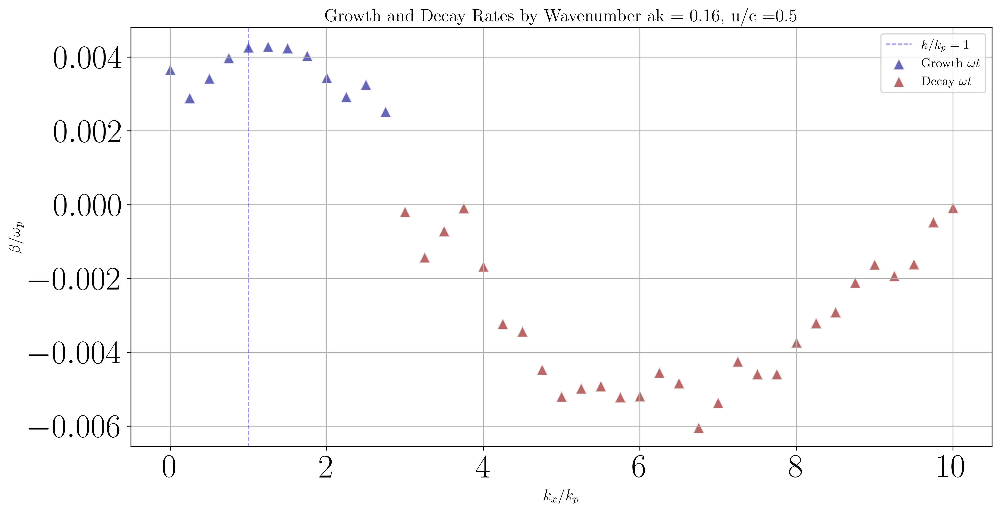

In [293]:
fig, ax = plt.subplots(figsize=(14, 7))
plt.scatter([k/4 for k in k_growth], [beta/omegap for beta in beta_growth], c='darkblue', marker= "^", label=r'Growth $\omega t$', alpha=0.6, edgecolors='w', s=100)
plt.scatter([k/4 for k in k_decay], [beta/omegap for beta in beta_decay], c='darkred', marker= "^", label=r'Decay $\omega t$ ', alpha=0.6, edgecolors='w', s=100)
# Añadir etiquetas y título
plt.xlabel(r'$k_x/k_p$', fontsize=14)
plt.ylabel(r'$\beta / \omega_{p}$', fontsize=14)
plt.title('Growth and Decay Rates by Wavenumber ak = 0.16, u/c =0.5', fontsize=16)
plt.axvline(x=1, color='blue', linestyle='--', linewidth=1, alpha= 0.4,  label=r'$k/k_{p}=1$')
# Añadir leyenda
plt.legend()

# Añadir cuadrícula para mejor visualización
plt.grid(True)

# Ajustar límites si es necesario
#plt.xlim([-0.2, 0.2])
#plt.ylim([-0.008, 0.008])

# Mostrar el gráfico
plt.show()

In [294]:
import pandas as pd
import numpy as np



# Crear DataFrames para crecimiento y decaimiento
df_growth = pd.DataFrame({
    'Tipo': 'Growth',
    'Beta': beta_growth,
    'k': k_growth
})

df_decay = pd.DataFrame({
    'Tipo': 'Decay',
    'Beta': beta_decay,
    'k': k_decay
})

# Concatenar los DataFrames verticalmente, llenando los valores faltantes con NaN
df_beta = pd.concat([df_growth, df_decay], axis=0).reset_index(drop=True)

# Guardar el DataFrame combinado en un archivo CSV
df_beta.to_csv('betas_kpHs016_upc05kx.csv', index=False)

In [288]:
print(omegap*(time-time[0]))

[ 0.         0.1963496  0.392699   0.5890486  0.7853982  0.9817476
  1.1780972  1.3744468  1.5707964  1.7671458  1.9634954  2.159845
  2.3561944  2.552544   2.7488936  2.945243   3.1415926  3.3379422
  3.5342918  3.7306412  3.9269908  4.1233404  4.3196898  4.5160394
  4.712389   4.9087386  5.105088   5.3014376  5.4977872  5.6941366
  5.8904862  6.0868358  6.2831852  6.4795348  6.6758844  6.872234
  7.0685834  7.264933   7.4612826  7.657632   7.8539816  8.0503312
  8.2466806  8.4430302  8.6393798  8.8357294  9.0320788  9.2284284
  9.424778   9.6211274  9.817477  10.0138266 10.2101762 10.4065256
 10.6028752 10.7992248 10.9955742 11.1919238 11.3882734 11.5846228
 11.7809724 11.977322  12.1736716 12.370021  12.5663706 12.7627202
 12.9590696 13.1554192 13.3517688 13.5481184 13.7444678 13.9408174
 14.137167  14.3335164 14.529866  14.7262156 14.922565  15.1189146
 15.3152642 15.5116138 15.7079632 15.9043128 16.1006624 16.2970118
 16.4933614 16.689711  16.8860604 17.08241   17.2787596 17.47510

x minimo 111.55344123567974
7
0.0


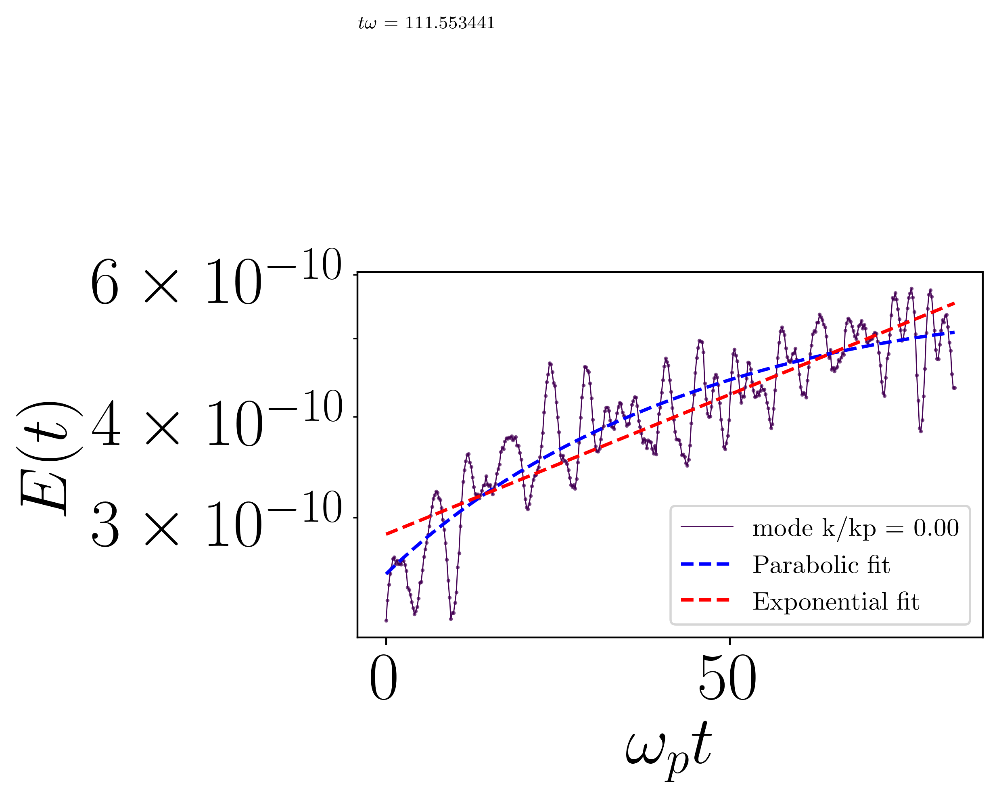

Parabolic fit: k/kp = 0.00,SSE = 6.14e-19, R^2 = 0.79139 time where behaviour changes $\omega t$ 111.55344123567974
RMSE of parabolic fit: 0.00000
a 2.8598046740506354e-10 b 0.007984140013609
[0.007984140013609] [] [0.0] []
Exponential fit: k/kp = 0.00, slope = 0.00798, SSE = 7.52e-19, R^2 = 0.74463
1
0.25
[0.007984140013609, 0.0058777957619892615] [] [0.0, 0.25] []


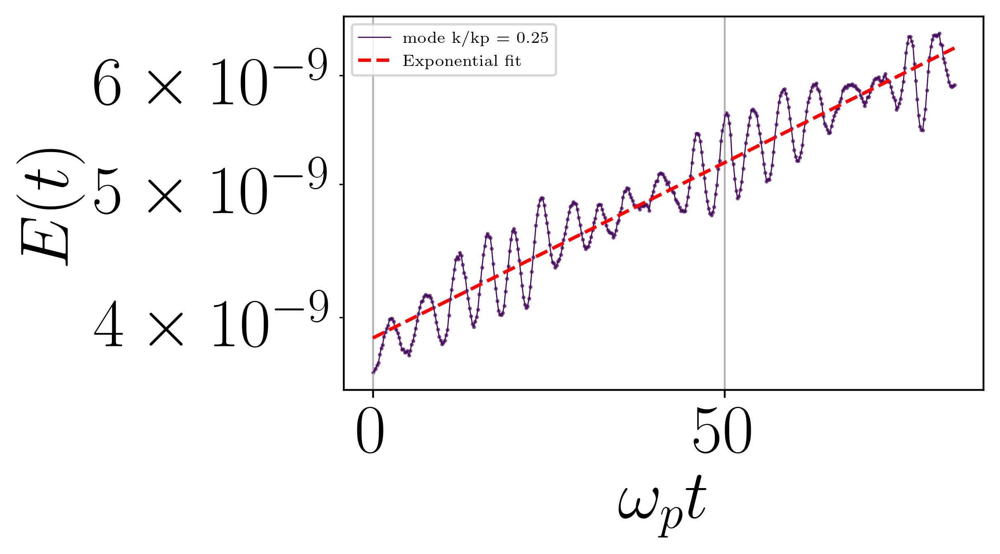

Exponential fit: k/kp = 0.25, slope = 0.00588, SSE = 1.81e-17, R^2 = 0.91755
1
0.5
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993] [] [0.0, 0.25, 0.5] []


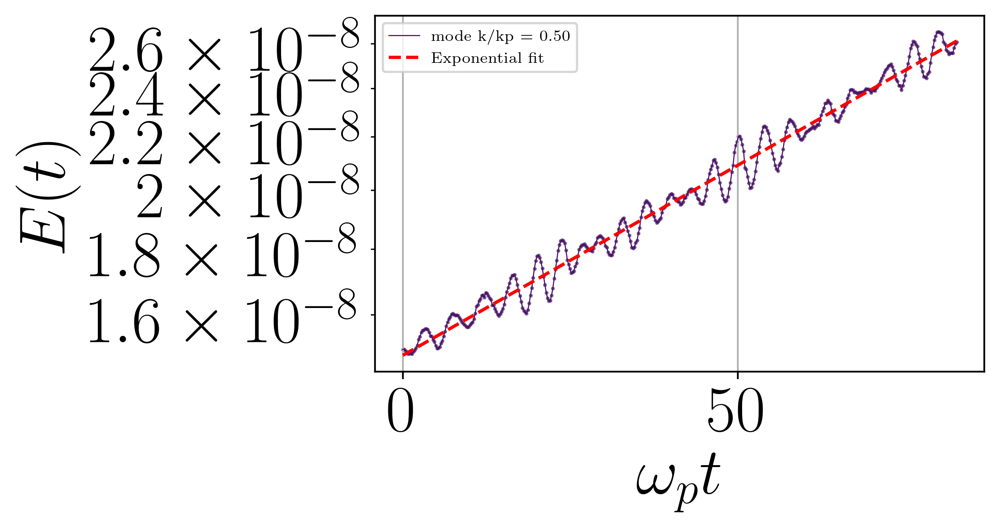

Exponential fit: k/kp = 0.50, slope = 0.00681, SSE = 8.52e-17, R^2 = 0.98135
1
0.75
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444] [] [0.0, 0.25, 0.5, 0.75] []


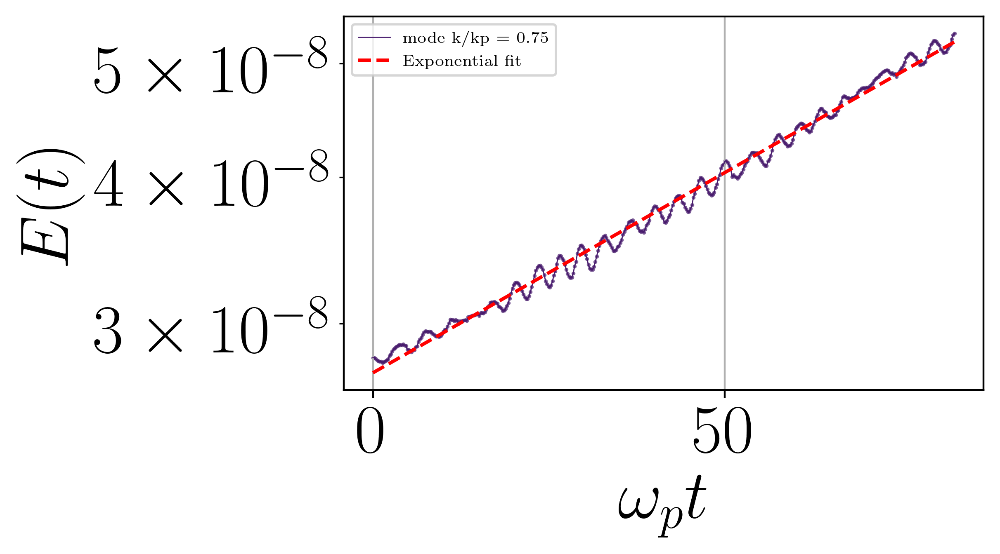

Exponential fit: k/kp = 0.75, slope = 0.00786, SSE = 1.51e-16, R^2 = 0.99326
1
1.0
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526] [] [0.0, 0.25, 0.5, 0.75, 1.0] []


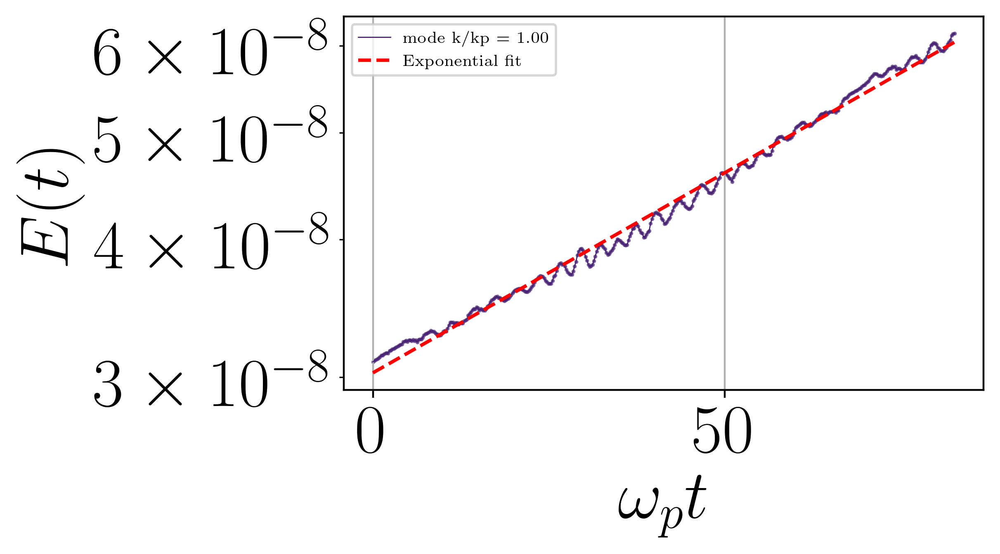

Exponential fit: k/kp = 1.00, slope = 0.00836, SSE = 2.02e-16, R^2 = 0.99389
1
1.25
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25] []


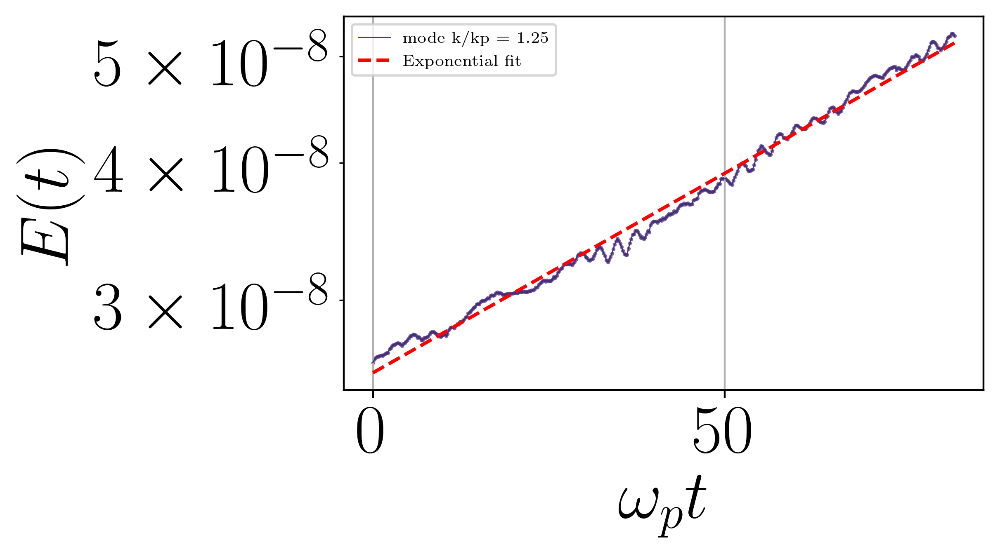

Exponential fit: k/kp = 1.25, slope = 0.00836, SSE = 1.89e-16, R^2 = 0.99218
1
1.5
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5] []


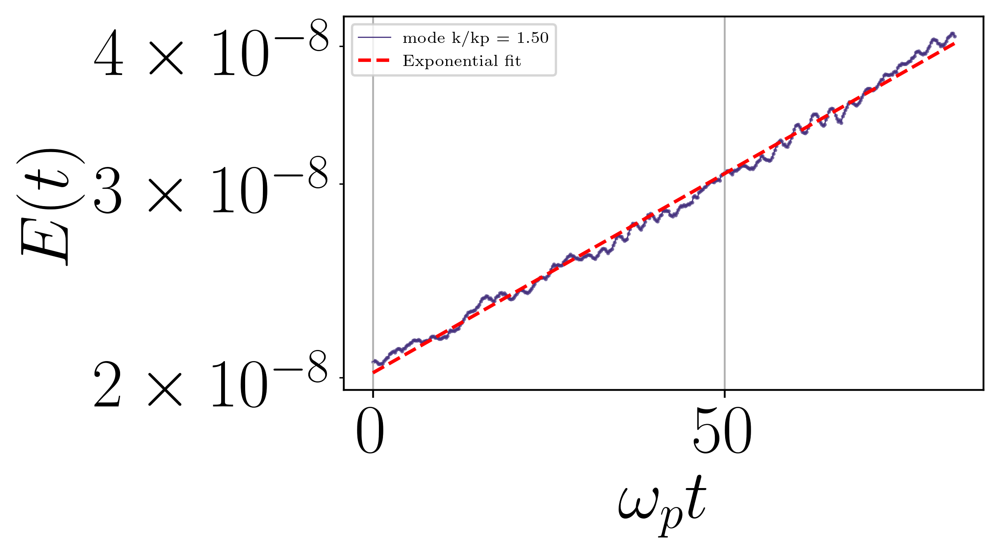

Exponential fit: k/kp = 1.50, slope = 0.00833, SSE = 7.70e-17, R^2 = 0.99469
1
1.75
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75] []


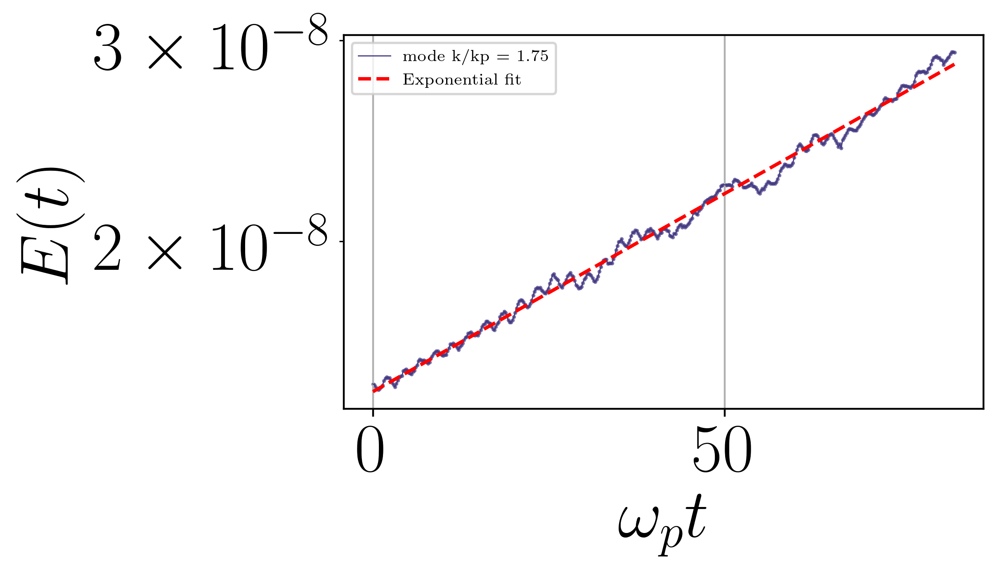

Exponential fit: k/kp = 1.75, slope = 0.00800, SSE = 5.03e-17, R^2 = 0.99268
1
2.0
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0] []


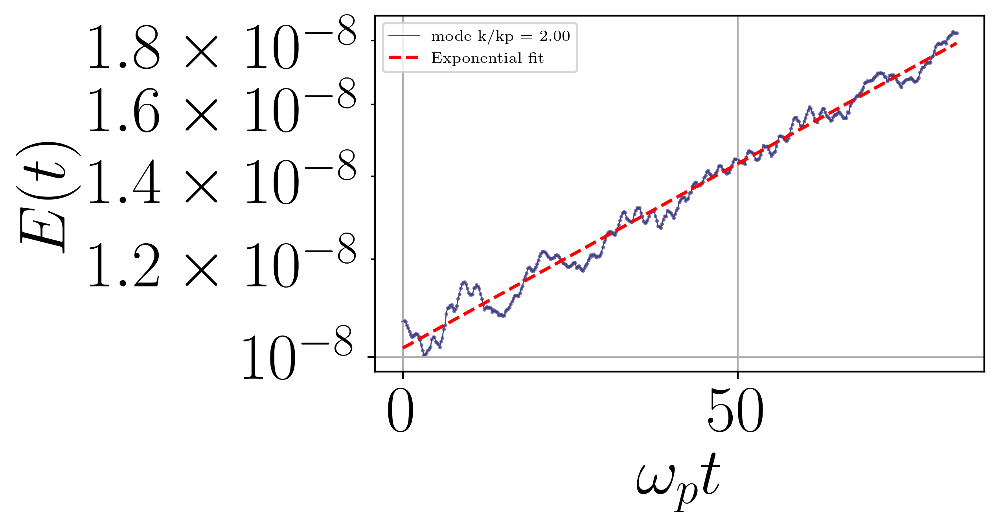

Exponential fit: k/kp = 2.00, slope = 0.00685, SSE = 2.83e-17, R^2 = 0.98689
1
2.25
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25] []


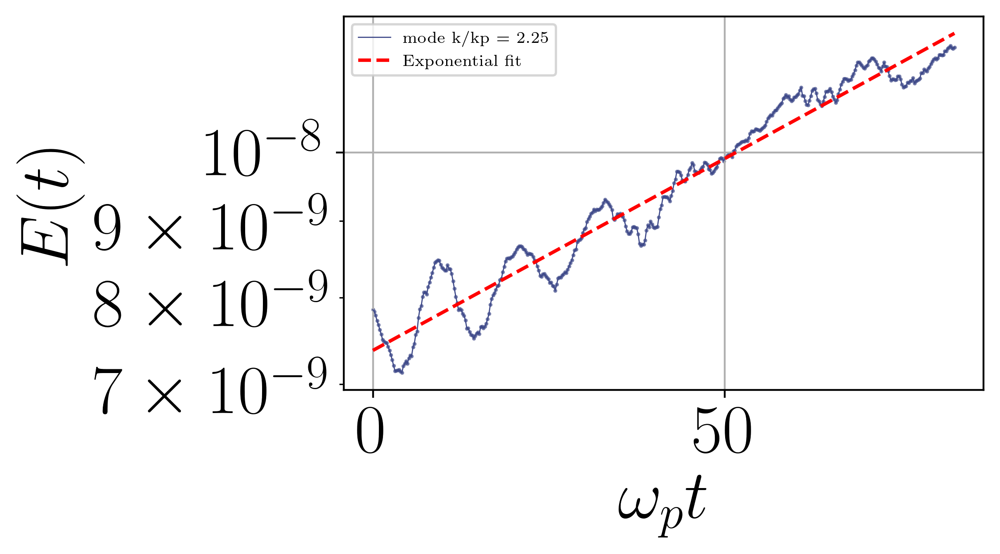

Exponential fit: k/kp = 2.25, slope = 0.00590, SSE = 3.53e-17, R^2 = 0.95490
1
2.5
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5] []


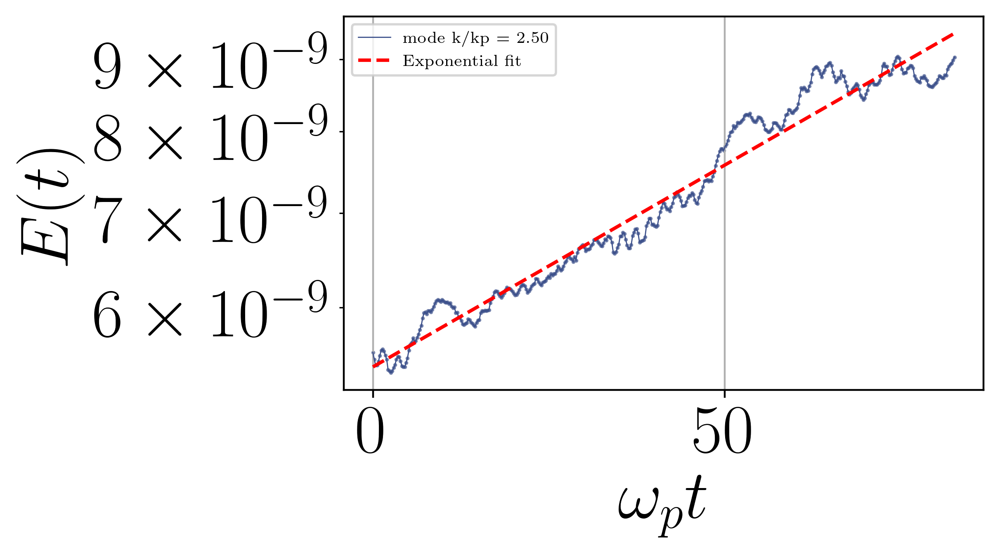

Exponential fit: k/kp = 2.50, slope = 0.00659, SSE = 2.49e-17, R^2 = 0.95579
1
2.75
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75] []


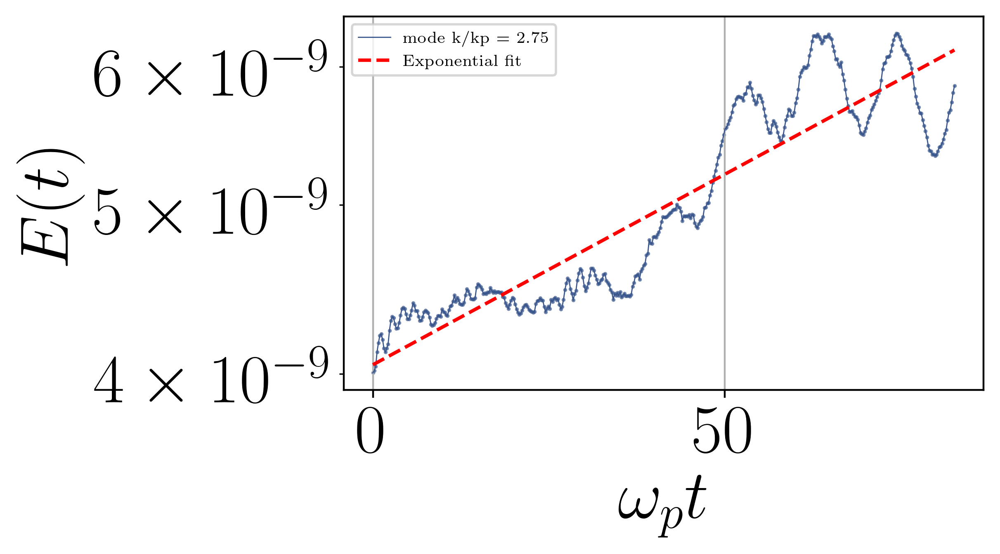

Exponential fit: k/kp = 2.75, slope = 0.00503, SSE = 3.63e-17, R^2 = 0.81110
x minimo 288.8285811841021
8
3.0


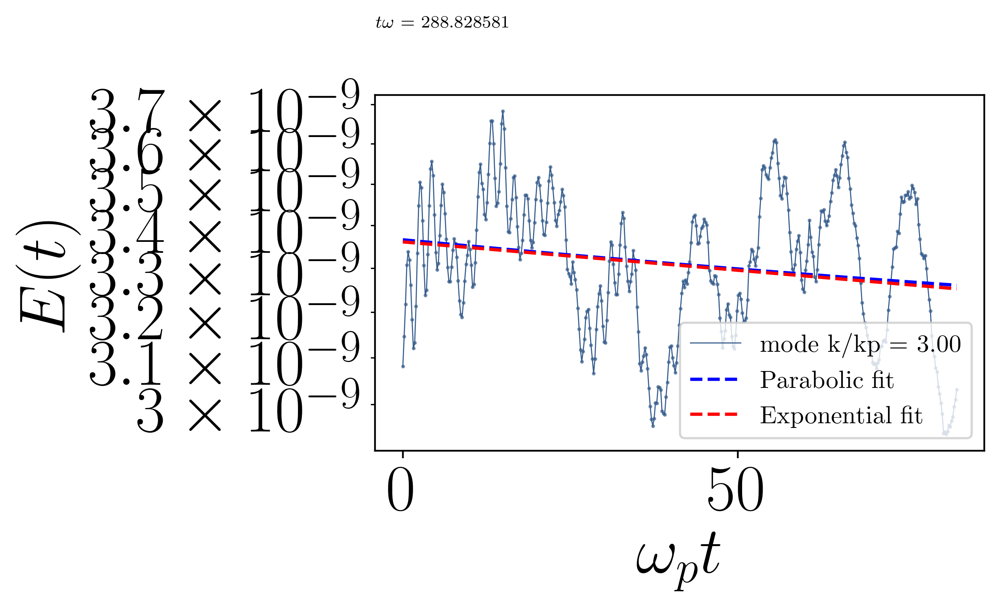

Parabolic fit: k/kp = 3.00,SSE = 1.08e-17, R^2 = 0.03503 time where behaviour changes $\omega t$ 288.8285811841021
RMSE of parabolic fit: 0.00000
a 3.3611537573716426e-09 b -0.00039709801610831013
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836] [-0.00039709801610831013] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75] [3.0]
Exponential fit: k/kp = 3.00, slope = -0.00040, SSE = 1.08e-17, R^2 = 0.03438
x minimo -31.276556260456776
8
3.25


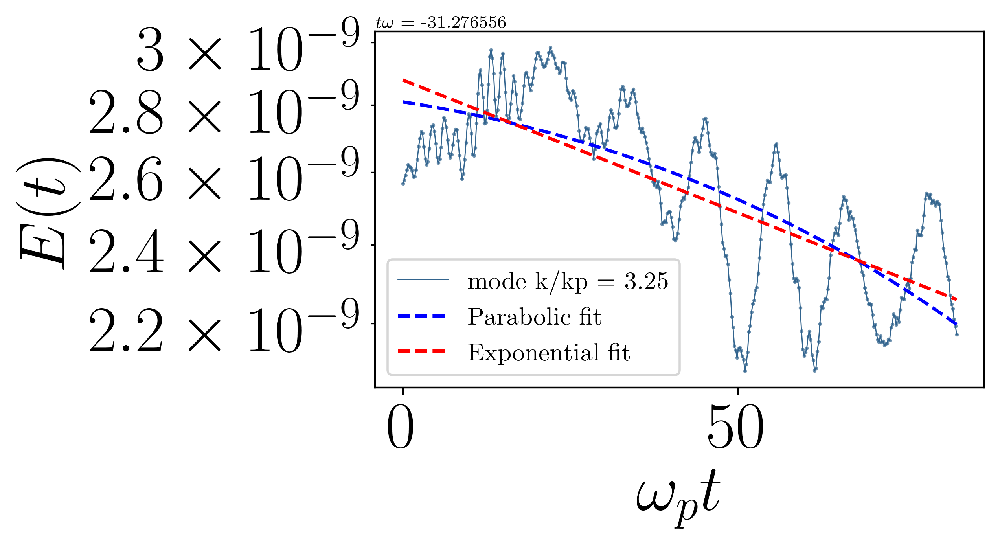

Parabolic fit: k/kp = 3.25,SSE = 1.10e-17, R^2 = 0.55129 time where behaviour changes $\omega t$ -31.276556260456776
RMSE of parabolic fit: 0.00000
a 2.8786396926060312e-09 b -0.002930521383472853
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836] [-0.00039709801610831013, -0.002930521383472853] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75] [3.0, 12, 3.25]
Exponential fit: k/kp = 3.25, slope = -0.00293, SSE = 1.15e-17, R^2 = 0.53306
x minimo 27.216897141606612


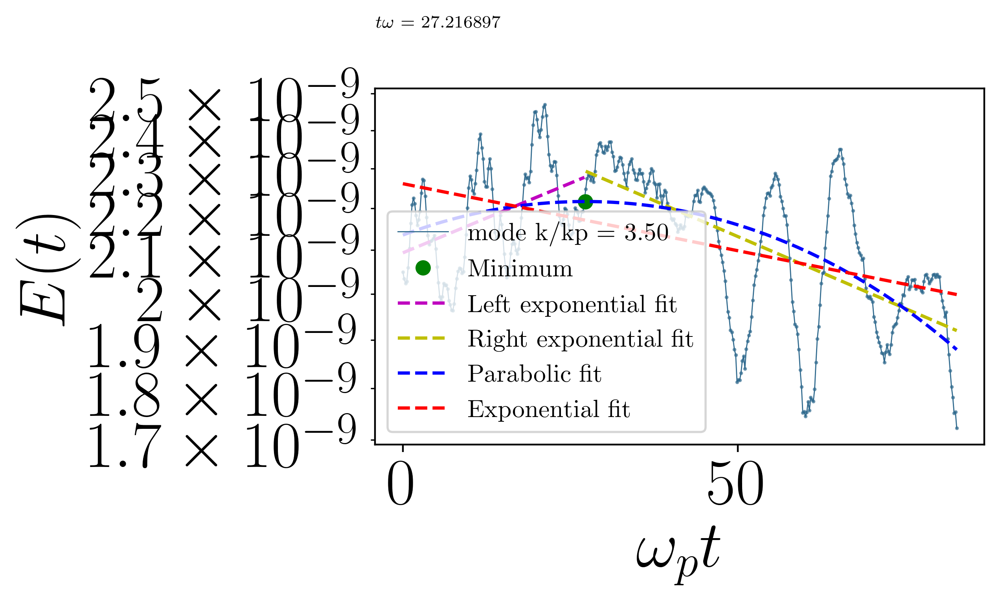

Parabolic fit: k/kp = 3.50,SSE = 7.44e-18, R^2 = 0.32905 time where behaviour changes $\omega t$ 27.216897141606612
RMSE of parabolic fit: 0.00000
a 2.2614911302488487e-09 b -0.001495217061042786
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5] [3.0, 12, 3.25, 13, 3.5]
Exponential fit: k/kp = 3.50, slope = -0.00150, SSE = 8.84e-18, R^2 = 0.20263
x minimo 13.393632237286475


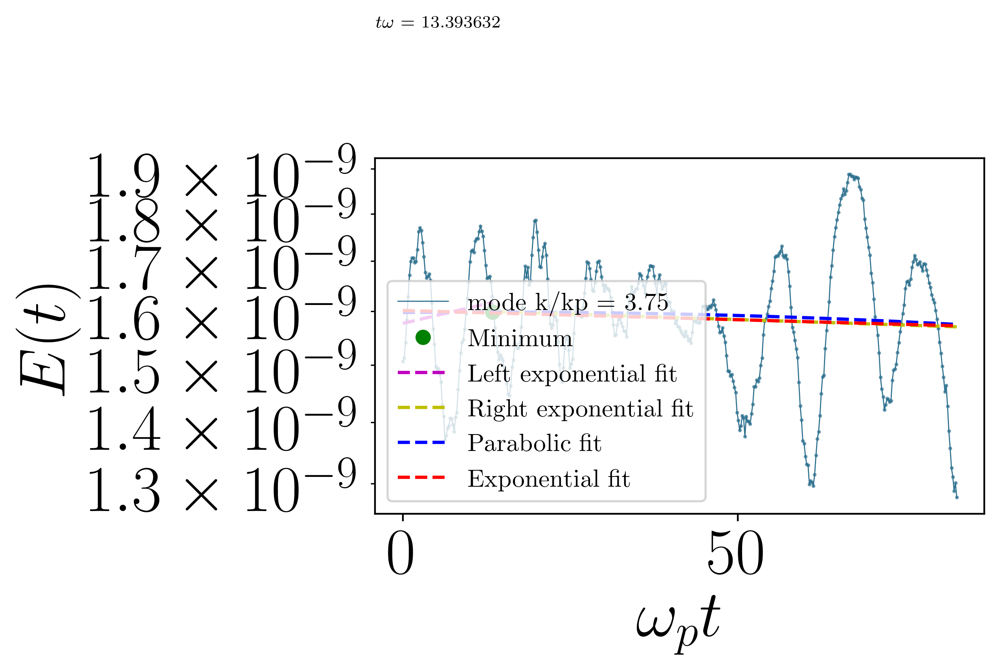

Parabolic fit: k/kp = 3.75,SSE = 6.52e-18, R^2 = 0.00320 time where behaviour changes $\omega t$ 13.393632237286475
RMSE of parabolic fit: 0.00000
a 1.6018198321484129e-09 b -0.00022305922349335008
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75] [3.0, 12, 3.25, 13, 3.5, 14, 3.75]
Exponential fit: k/kp = 3.75, slope = -0.00022, SSE = 6.54e-18, R^2 = 0.00100
x minimo 61.70762124000269


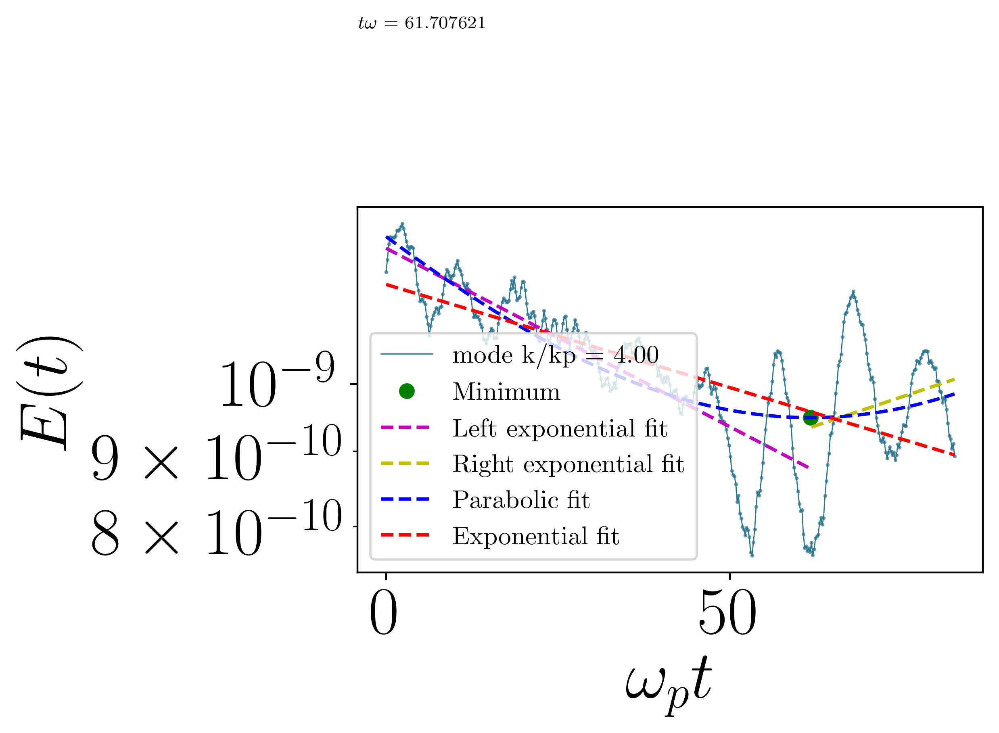

Parabolic fit: k/kp = 4.00,SSE = 2.22e-18, R^2 = 0.60584 time where behaviour changes $\omega t$ 61.70762124000269
RMSE of parabolic fit: 0.00000
a 1.1683649676522264e-09 b -0.003229048453668205
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75, 4.0] [3.0, 12, 3.25, 13, 3.5, 14, 3.75, 15, 4.0]
Exponential fit: k/kp = 4.00, slope = -0.00323, SSE = 2.87e-18, R^2 = 0.49032
2
4.25
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395

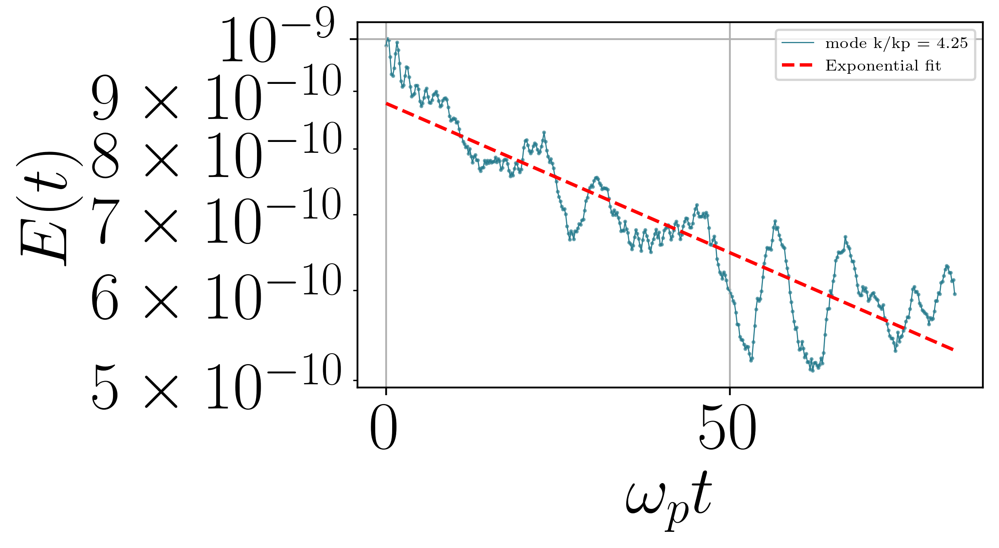

Exponential fit: k/kp = 4.25, slope = -0.00607, SSE = 9.14e-19, R^2 = 0.83475
x minimo 62.04690657886587


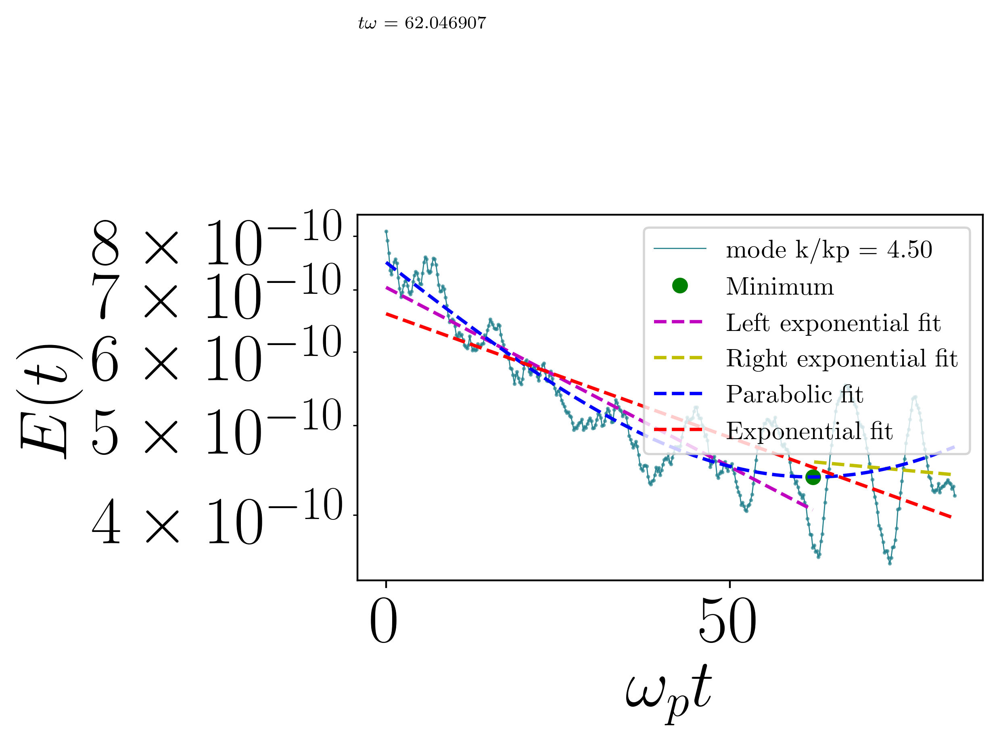

Parabolic fit: k/kp = 4.50,SSE = 6.61e-19, R^2 = 0.83708 time where behaviour changes $\omega t$ 62.04690657886587
RMSE of parabolic fit: 0.00000
a 6.5946397243014e-10 b -0.0061443595692419264
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75, 4.0] [3.0, 12, 3.25, 13, 3.5, 14, 3.75, 15, 4.0, 16, 4.25, 17, 4.5, 4.5]
Exponential fit: k/kp = 4.50, slope = -0.00614, SSE = 1.22e-18, R^2 = 0.69856
x minimo 63.30157599825807


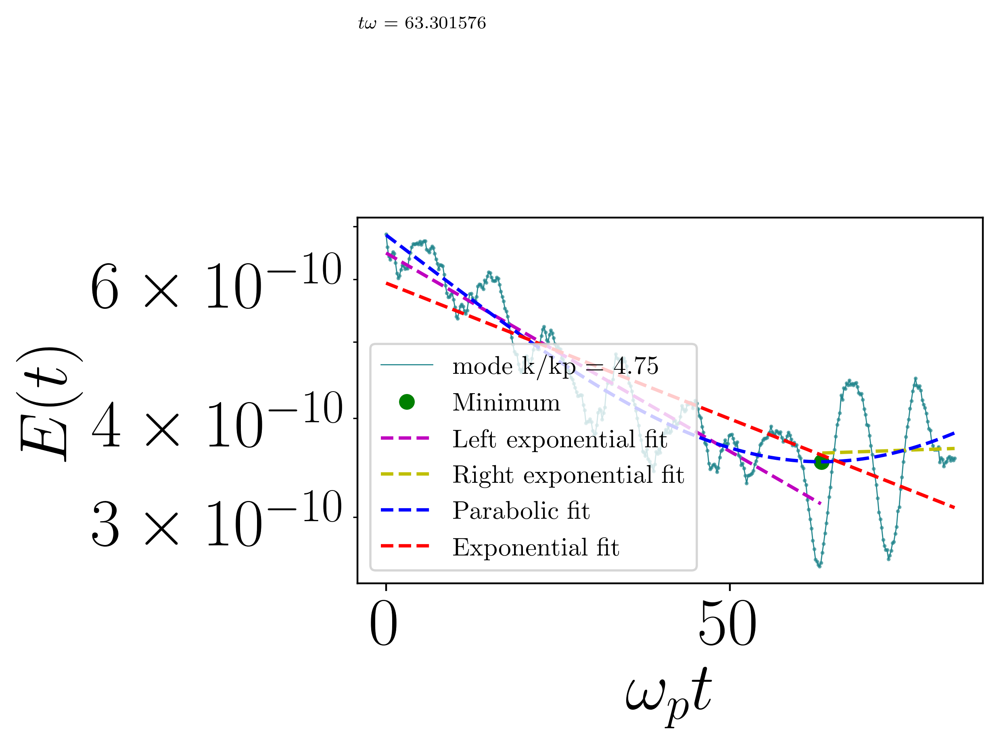

Parabolic fit: k/kp = 4.75,SSE = 6.70e-19, R^2 = 0.85398 time where behaviour changes $\omega t$ 63.30157599825807
RMSE of parabolic fit: 0.00000
a 5.934585217484289e-10 b -0.00792186982179639
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75, 4.0, 4.75] [3.0, 12, 3.25, 13, 3.5, 14, 3.75, 15, 4.0, 16, 4.25, 17, 4.5, 4.5, 18, 4.75]
Exponential fit: k/kp = 4.75, slope = -0.00792, SSE = 1.21e-18, R^2 = 0.736

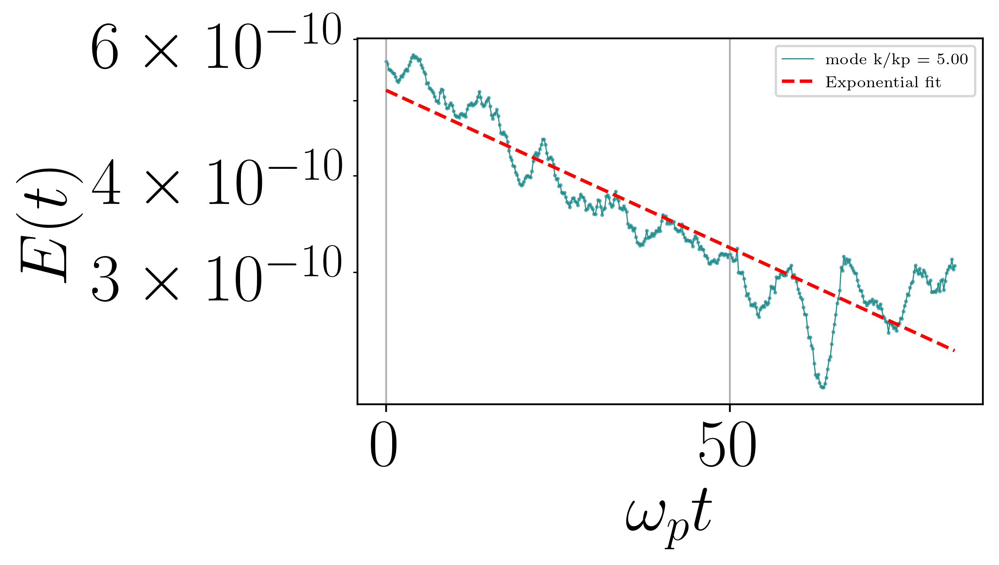

Exponential fit: k/kp = 5.00, slope = -0.00937, SSE = 4.16e-19, R^2 = 0.88298
2
5.25
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75, 4.0, 4.75] [3.0, 12, 3.25, 13, 3.5, 14, 3.75, 15, 4.0, 16, 4.25, 17, 4.5, 4.5, 18, 4.75, 19, 5.0, 20, 5.25]


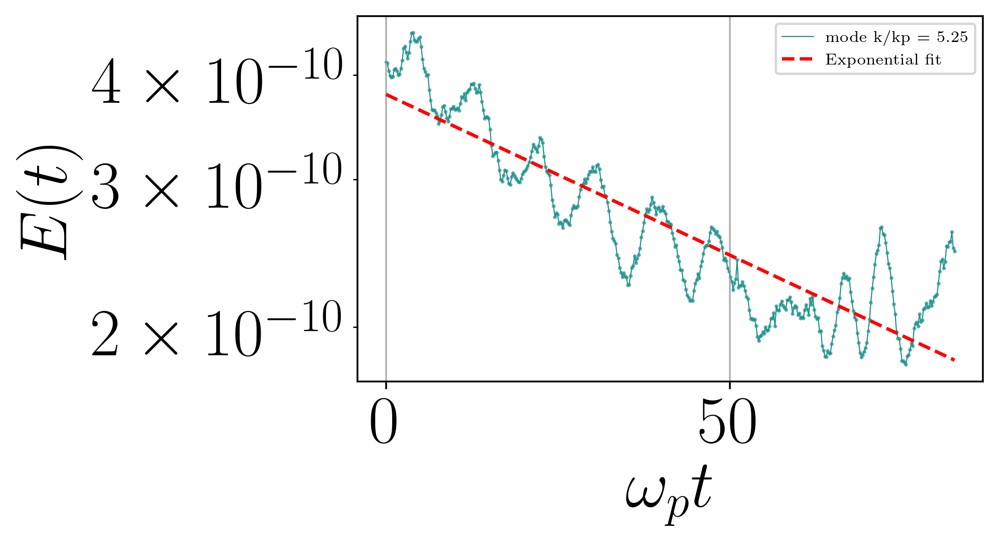

Exponential fit: k/kp = 5.25, slope = -0.00883, SSE = 3.56e-19, R^2 = 0.81845
x minimo 65.32646979850297


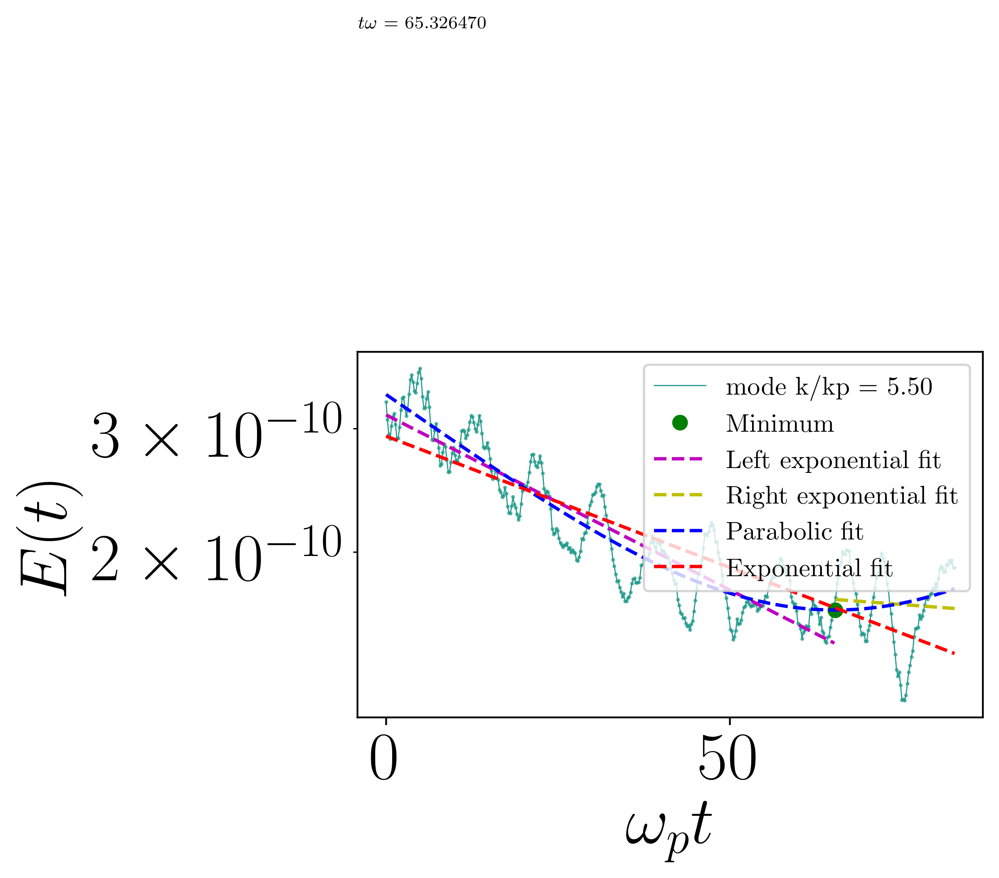

Parabolic fit: k/kp = 5.50,SSE = 1.74e-19, R^2 = 0.85886 time where behaviour changes $\omega t$ 65.32646979850297
RMSE of parabolic fit: 0.00000
a 2.925277016471057e-10 b -0.008632643996054543
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75, 4.0, 4.75] [3.0, 12, 3.25, 13, 3.5, 14, 3.75, 15, 4.0, 16, 4.25, 17, 4.

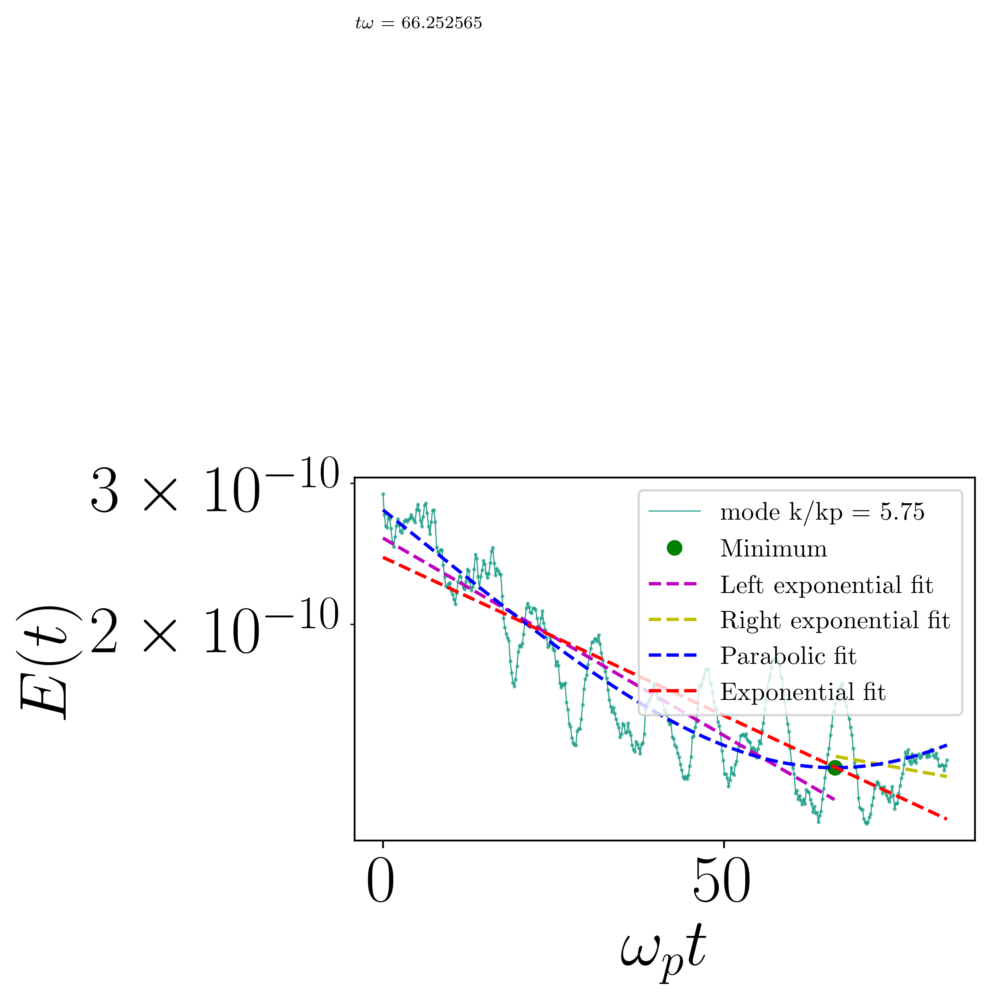

Parabolic fit: k/kp = 5.75,SSE = 1.17e-19, R^2 = 0.86963 time where behaviour changes $\omega t$ 66.25256479869878
RMSE of parabolic fit: 0.00000
a 2.424653527154083e-10 b -0.0090939348760044
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539879841] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.5, 3.75, 4.0, 4.75] [3.0, 12, 3.25, 1

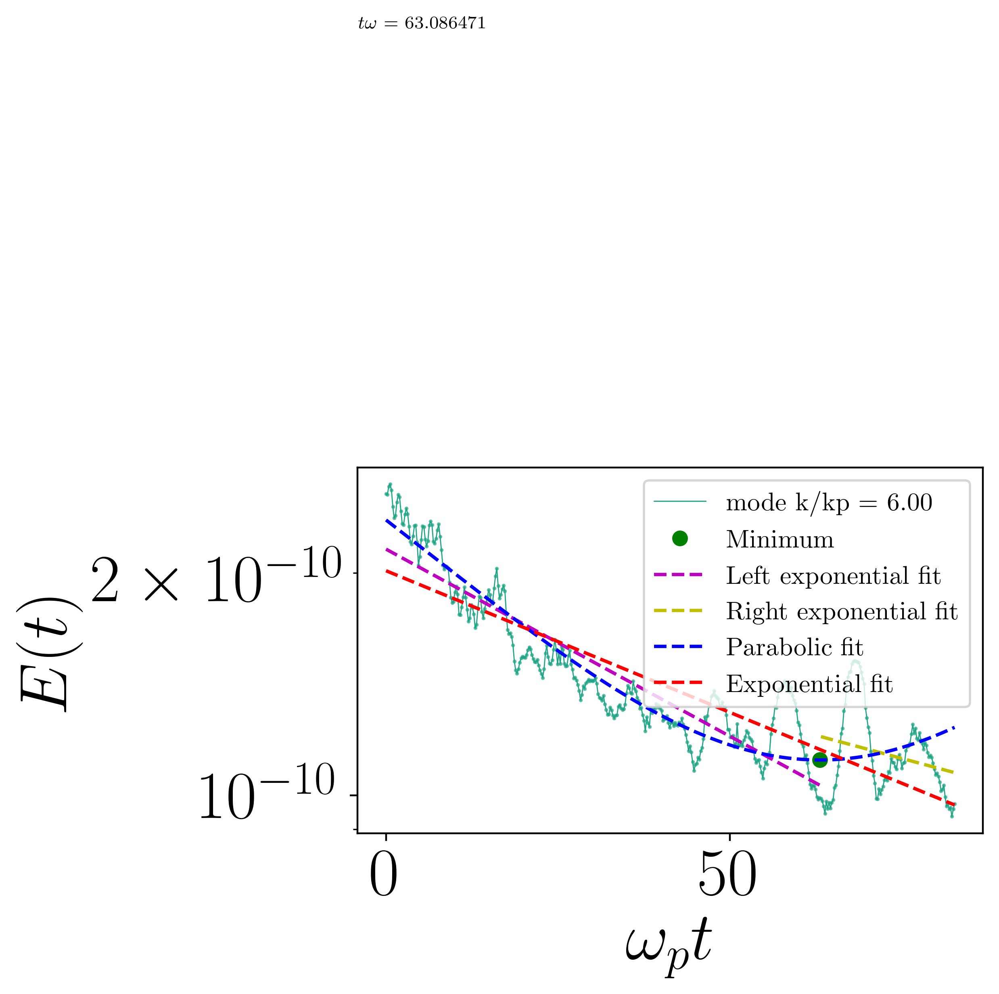

Parabolic fit: k/kp = 6.00,SSE = 7.75e-20, R^2 = 0.87673 time where behaviour changes $\omega t$ 63.086471038288416
RMSE of parabolic fit: 0.00000
a 2.0124610424000462e-10 b -0.008817673290823108
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539879841, -0.011649067776899133, -0.005767898680710603] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 

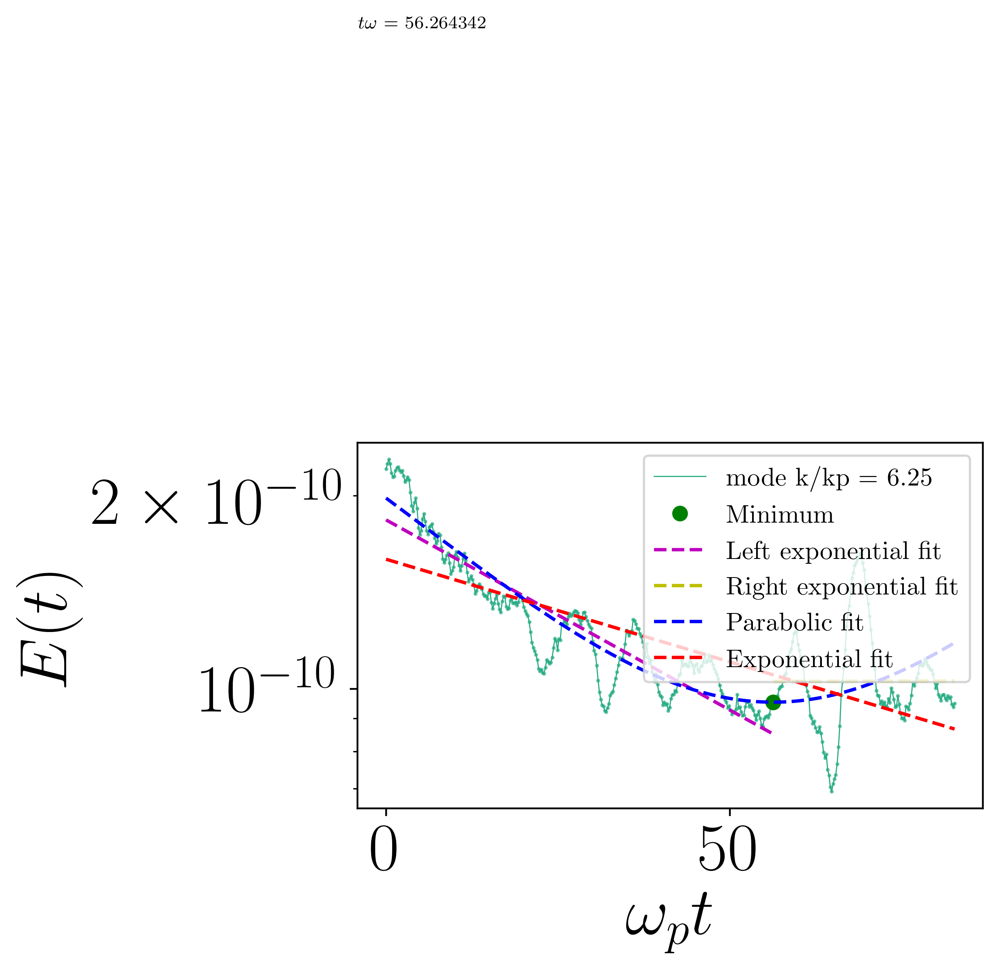

Parabolic fit: k/kp = 6.25,SSE = 1.06e-19, R^2 = 0.76423 time where behaviour changes $\omega t$ 56.264341705492654
RMSE of parabolic fit: 0.00000
a 1.5918205273607058e-10 b -0.007353329644315779
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539879841, -0.011649067776899133, -0.005767898680710603, -0.013617725104071866] [0.0, 0.25

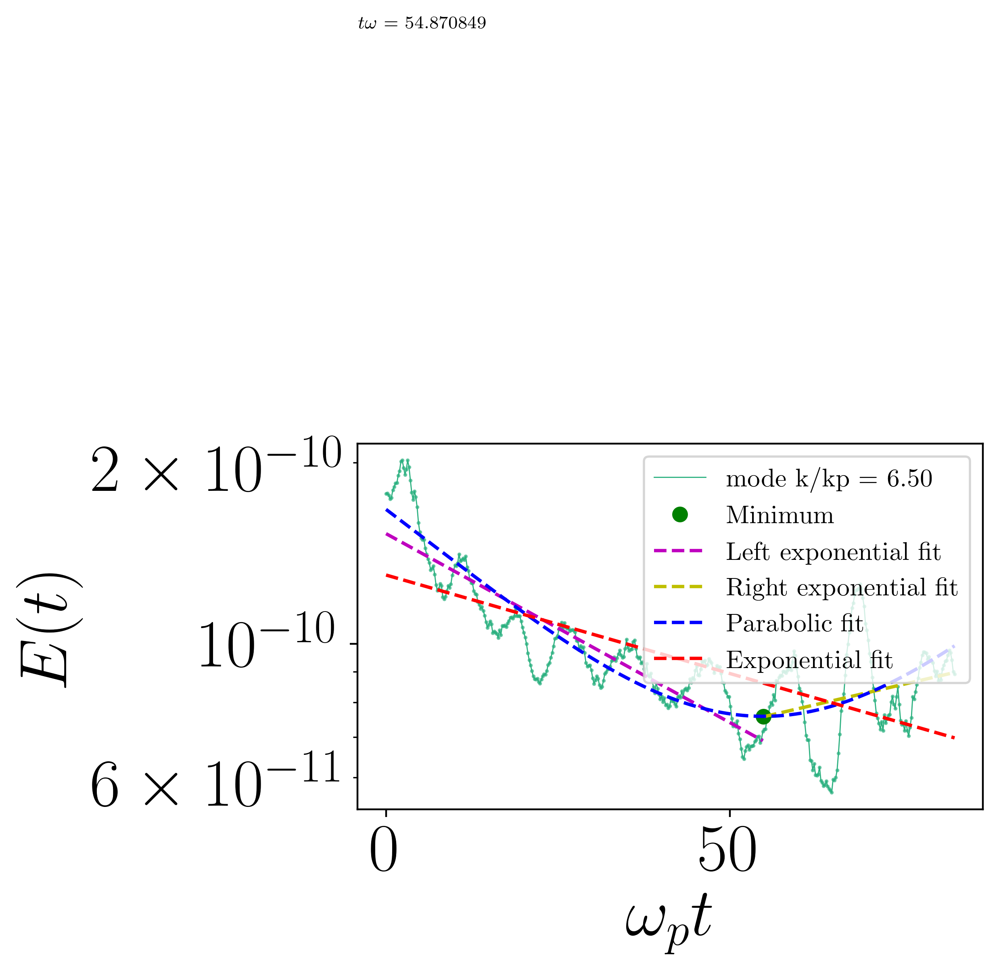

Parabolic fit: k/kp = 6.50,SSE = 8.01e-20, R^2 = 0.76831 time where behaviour changes $\omega t$ 54.87084850106211
RMSE of parabolic fit: 0.00000
a 1.3016919169952246e-10 b -0.007534886644313407
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539879841, -0.011649067776899133, -0.005767898680710603, -0.01361772

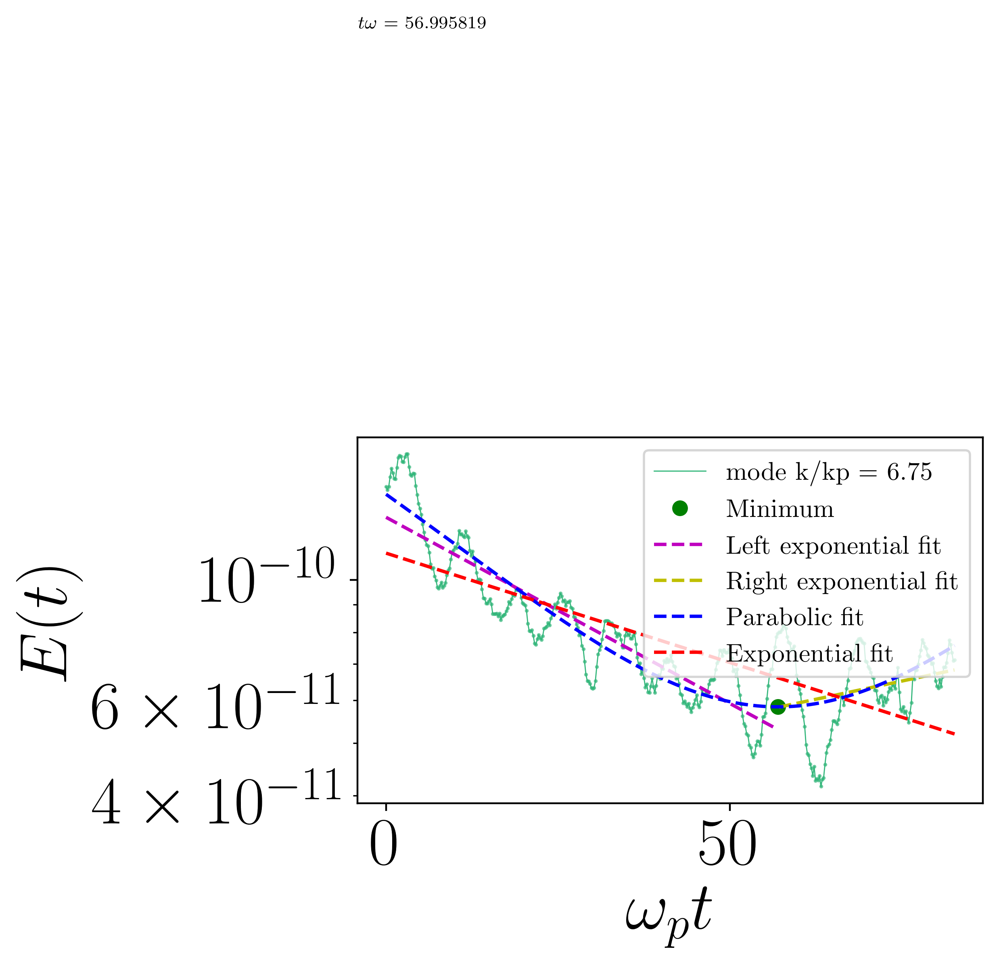

Parabolic fit: k/kp = 6.75,SSE = 5.16e-20, R^2 = 0.82328 time where behaviour changes $\omega t$ 56.99581936815507
RMSE of parabolic fit: 0.00000
a 1.1196754272057649e-10 b -0.009287278472475572
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539879841, -0.011649067776899133, -0.005767898

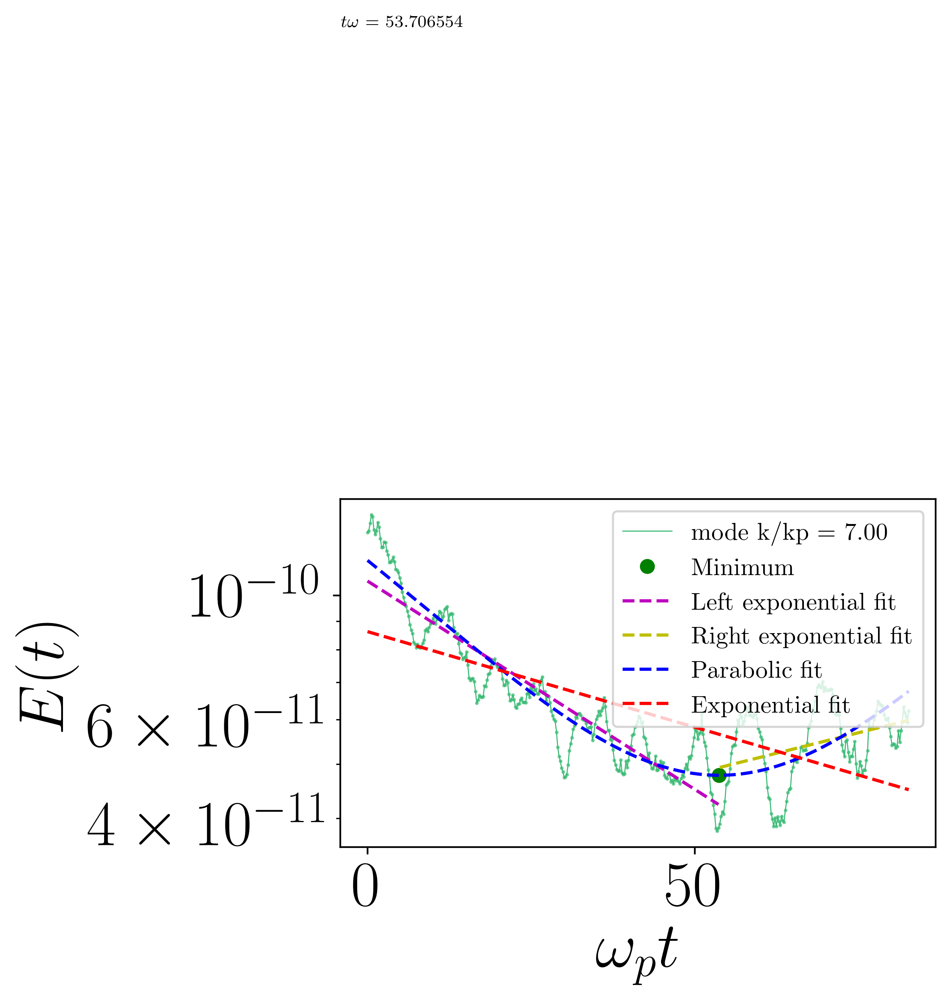

Parabolic fit: k/kp = 7.00,SSE = 2.67e-20, R^2 = 0.84235 time where behaviour changes $\omega t$ 53.70655447415326
RMSE of parabolic fit: 0.00000
a 8.61757094915661e-11 b -0.007861524021785181
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539879841, -0.011649067776

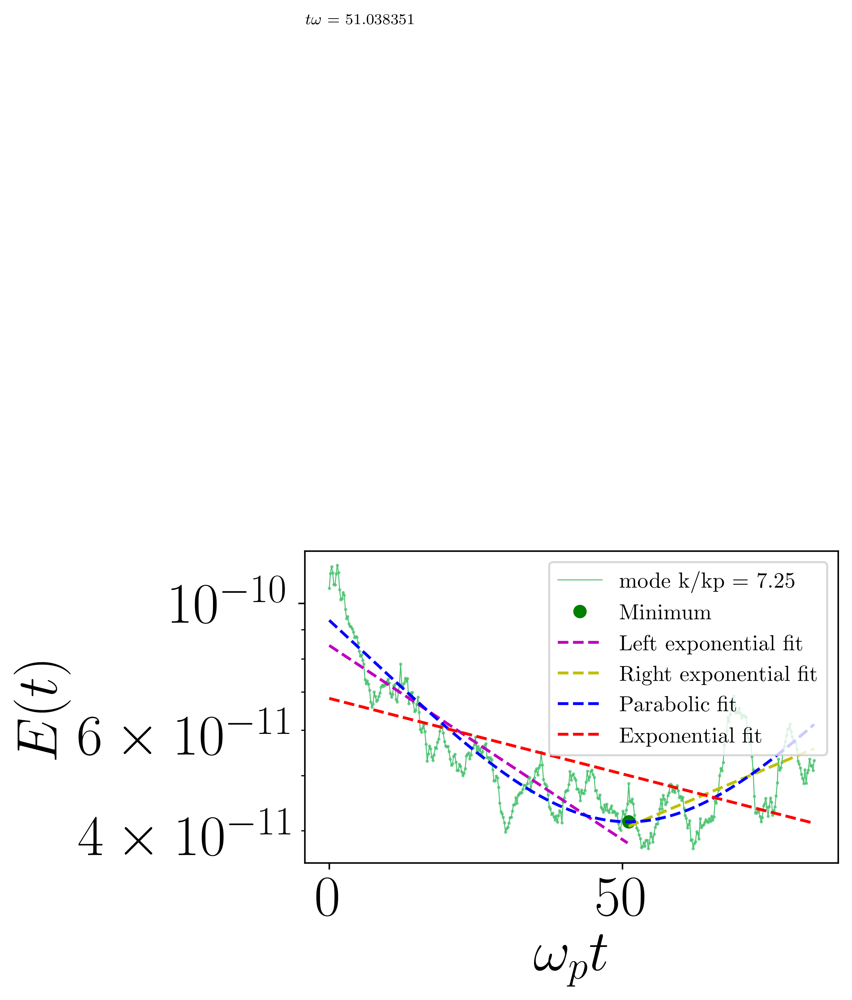

Parabolic fit: k/kp = 7.25,SSE = 2.03e-20, R^2 = 0.79787 time where behaviour changes $\omega t$ 51.038351237525134
RMSE of parabolic fit: 0.00000
a 6.822387525983152e-11 b -0.006092532351124605
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.011346021164256818, -0.00354928539

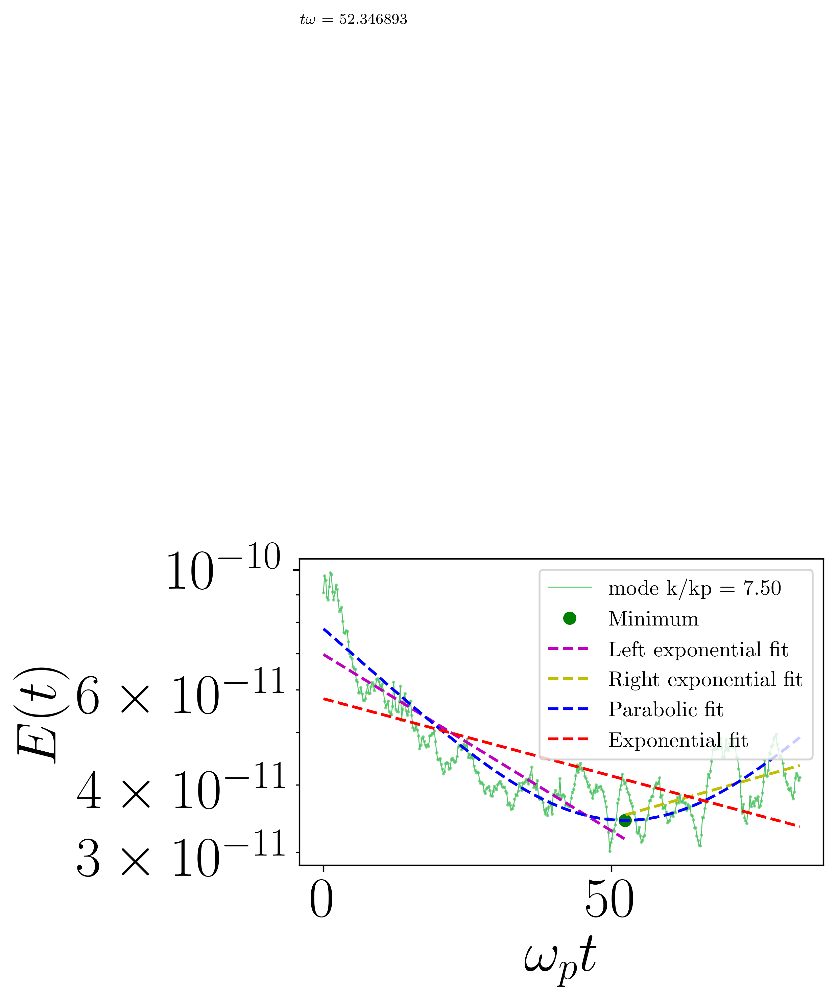

Parabolic fit: k/kp = 7.50,SSE = 1.26e-20, R^2 = 0.81947 time where behaviour changes $\omega t$ 52.34689340456357
RMSE of parabolic fit: 0.00000
a 5.772838035060835e-11 b -0.006592854812585573
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.001703059997852446, -0.0113460211642

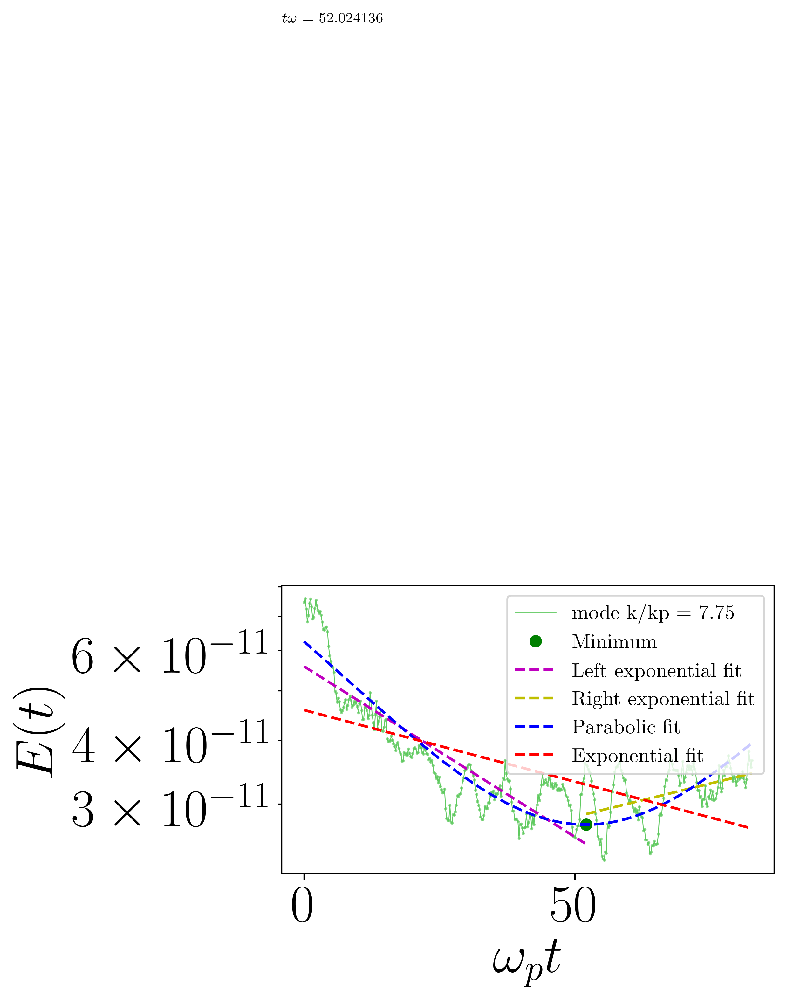

Parabolic fit: k/kp = 7.75,SSE = 8.72e-21, R^2 = 0.81002 time where behaviour changes $\omega t$ 52.024136165626444
RMSE of parabolic fit: 0.00000
a 4.5822880357532766e-11 b -0.006467823544665433
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.011496898282430069, -0.0017030599978

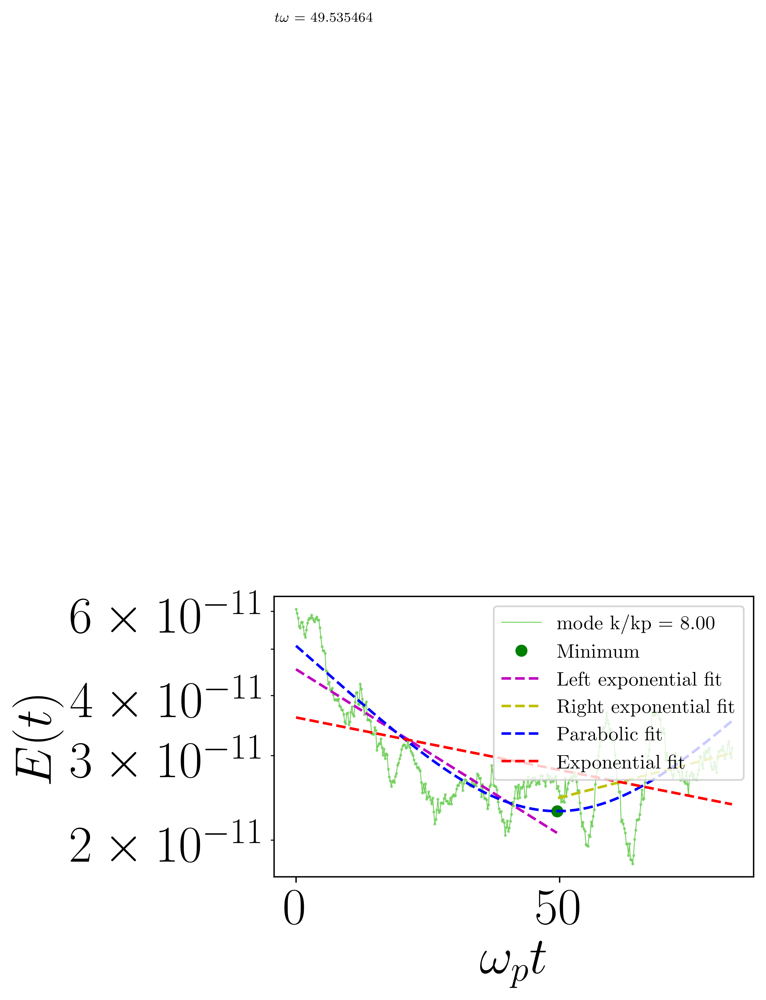

Parabolic fit: k/kp = 8.00,SSE = 8.83e-21, R^2 = 0.71880 time where behaviour changes $\omega t$ 49.53546433768863
RMSE of parabolic fit: 0.00000
a 3.600537028235407e-11 b -0.005043445646171914
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.008834631932408094, -0.0114968982824300

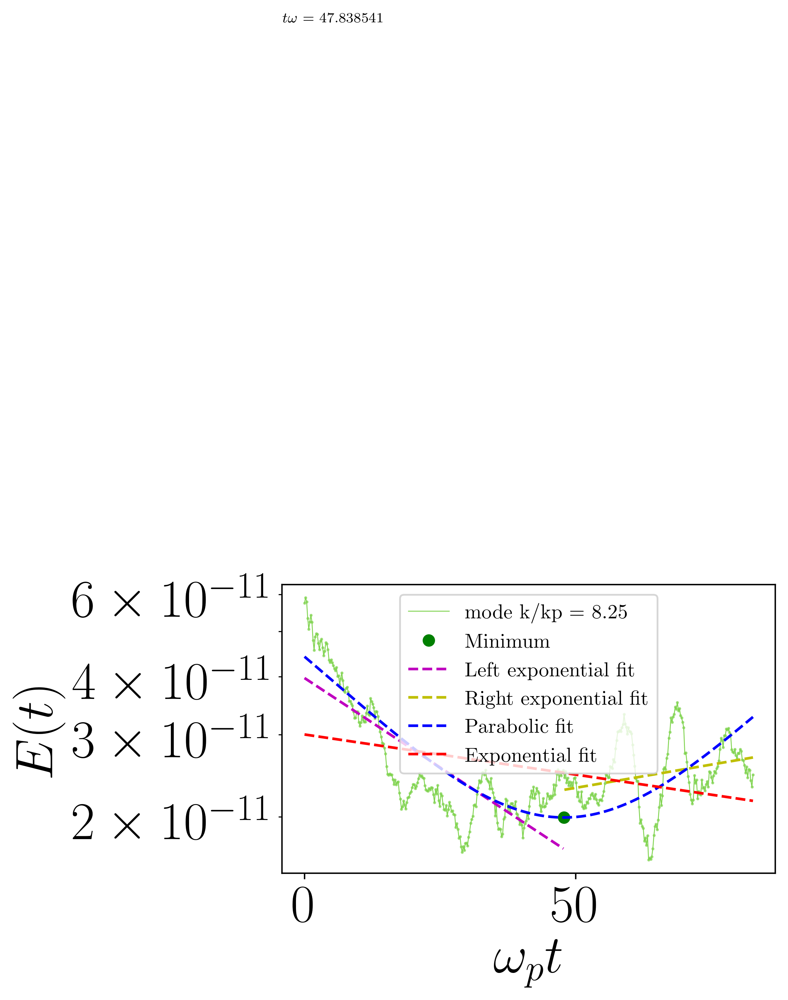

Parabolic fit: k/kp = 8.25,SSE = 8.98e-21, R^2 = 0.65329 time where behaviour changes $\omega t$ 47.83854094935812
RMSE of parabolic fit: 0.00000
a 3.004184554764062e-11 b -0.003968146947341696
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.009373417704586143, -0.00883463193240809

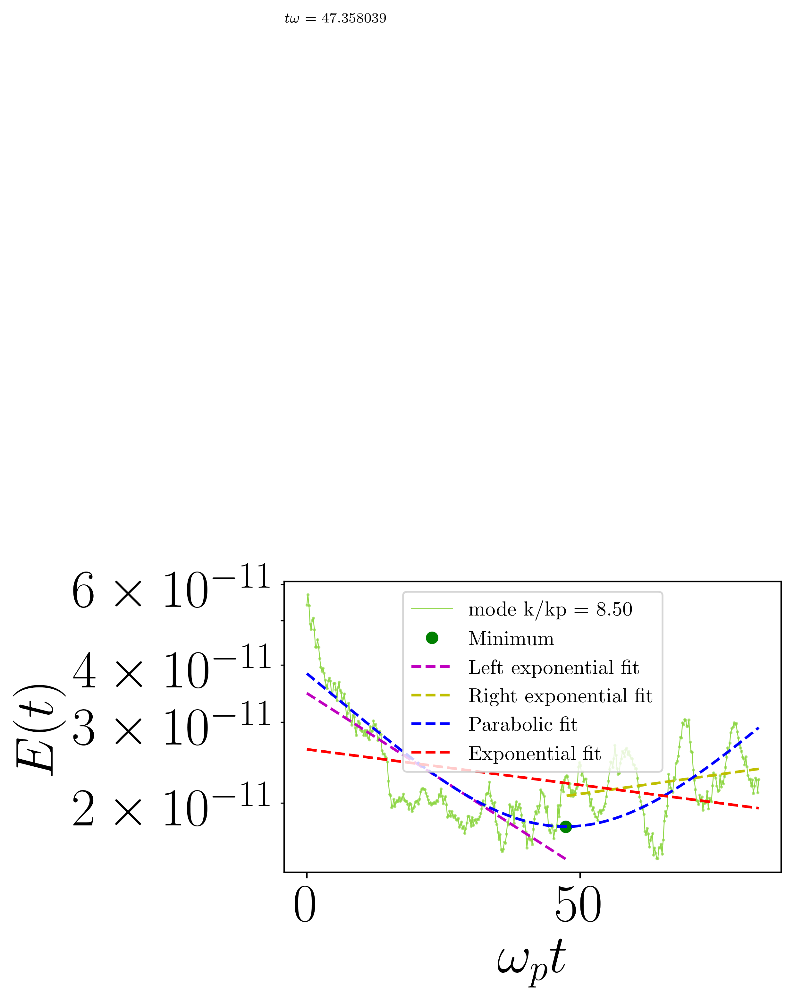

Parabolic fit: k/kp = 8.50,SSE = 6.90e-21, R^2 = 0.63998 time where behaviour changes $\omega t$ 47.35803900863678
RMSE of parabolic fit: 0.00000
a 2.6180723492441758e-11 b -0.0035840014620556492
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.011567351571490369, -0.0093734177045861

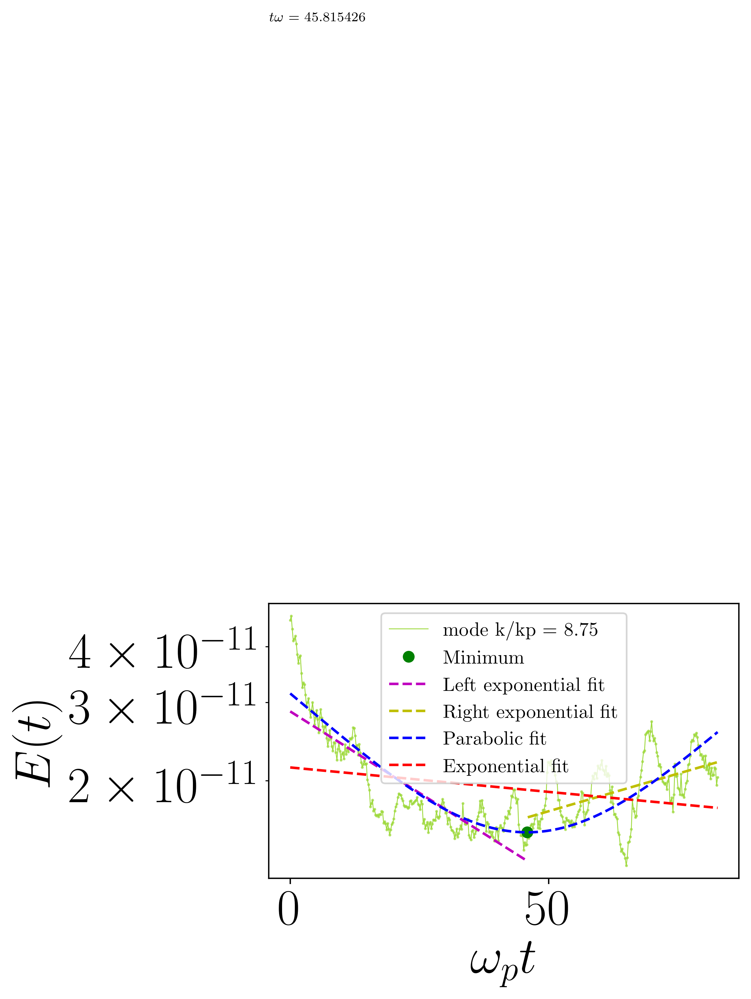

Parabolic fit: k/kp = 8.75,SSE = 4.20e-21, R^2 = 0.64447 time where behaviour changes $\omega t$ 45.81542631738066
RMSE of parabolic fit: 0.00000
a 2.1422301849928017e-11 b -0.0025255485125204413
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323, 0.007766101691141534] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.001558568905460977, -0.01156735157149036

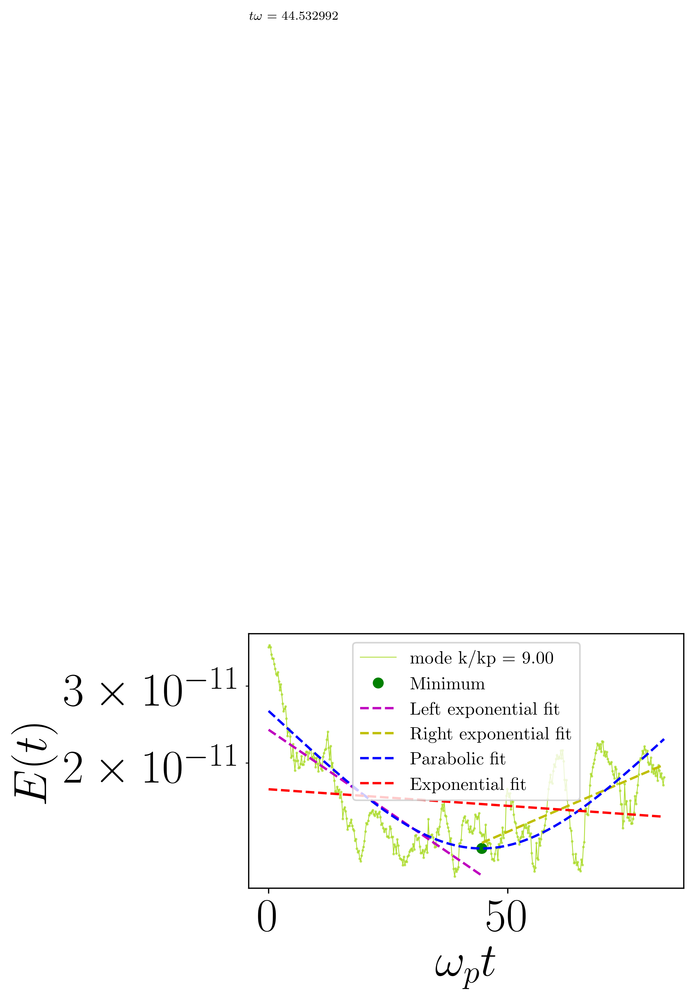

Parabolic fit: k/kp = 9.00,SSE = 3.52e-21, R^2 = 0.61570 time where behaviour changes $\omega t$ 44.532992126543014
RMSE of parabolic fit: 0.00000
a 1.7400073400440874e-11 b -0.0017545850461833028
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323, 0.007766101691141534, 0.010841068109069948] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -0.00155856890546097

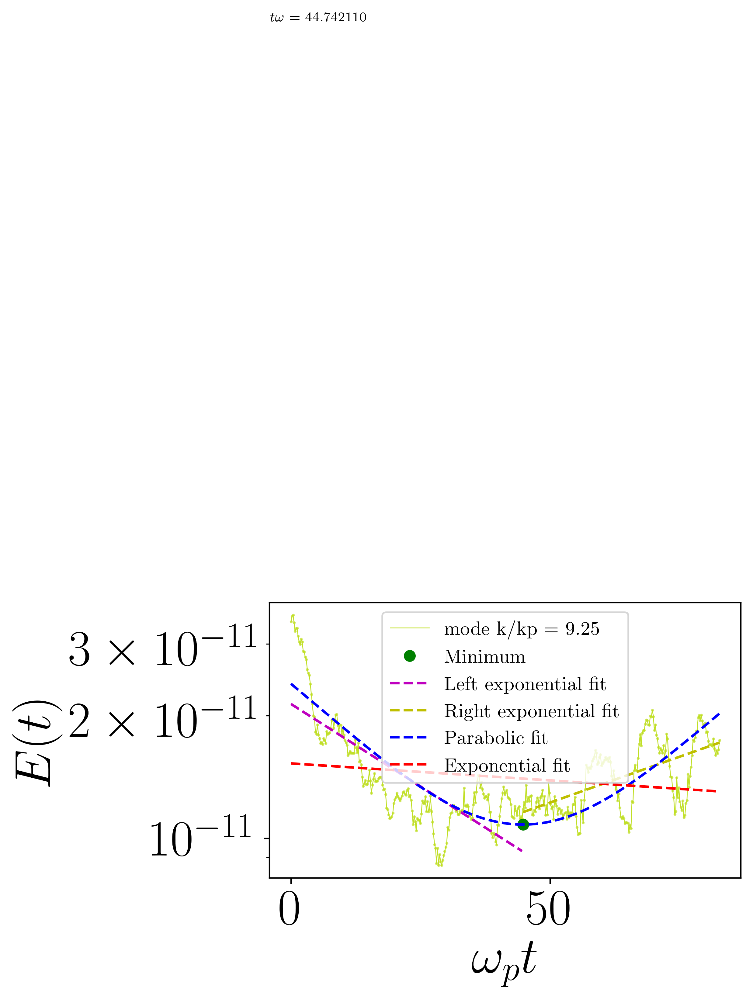

Parabolic fit: k/kp = 9.25,SSE = 3.31e-21, R^2 = 0.61247 time where behaviour changes $\omega t$ 44.7421103908541
RMSE of parabolic fit: 0.00000
a 1.5278723602893505e-11 b -0.001914487222706466
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323, 0.007766101691141534, 0.010841068109069948, 0.010351947026819665] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618, -0.008910475302130861, -

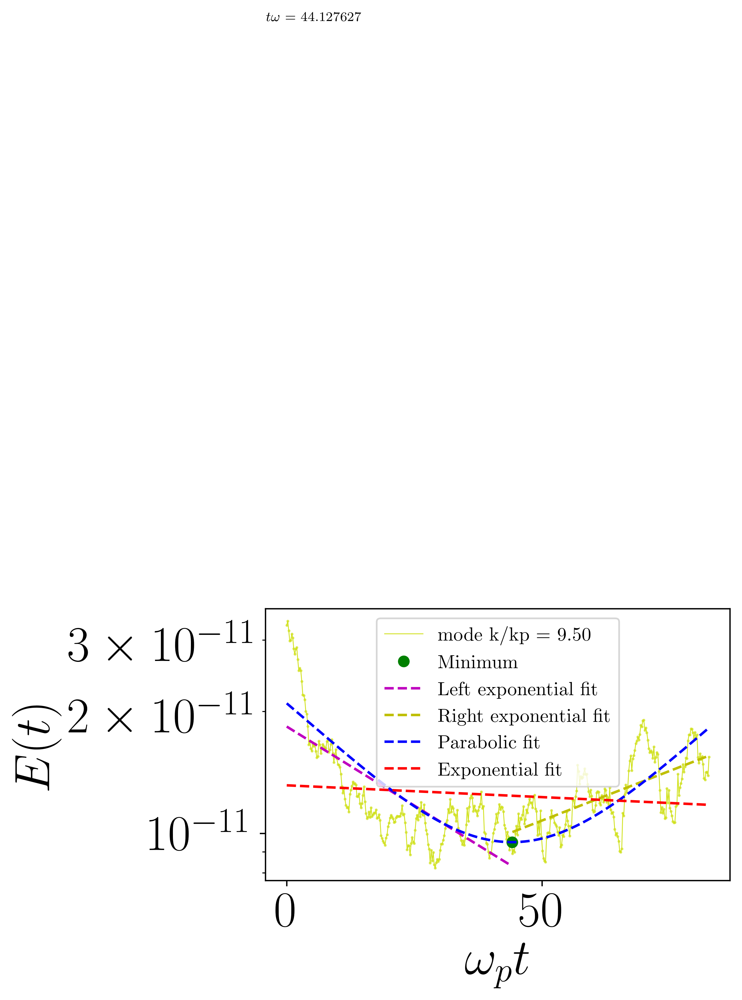

Parabolic fit: k/kp = 9.50,SSE = 3.09e-21, R^2 = 0.56760 time where behaviour changes $\omega t$ 44.127626648320096
RMSE of parabolic fit: 0.00000
a 1.3135140362463357e-11 b -0.0013407216464645733
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323, 0.007766101691141534, 0.010841068109069948, 0.010351947026819665, 0.011267177019095567] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.006071457356451618,

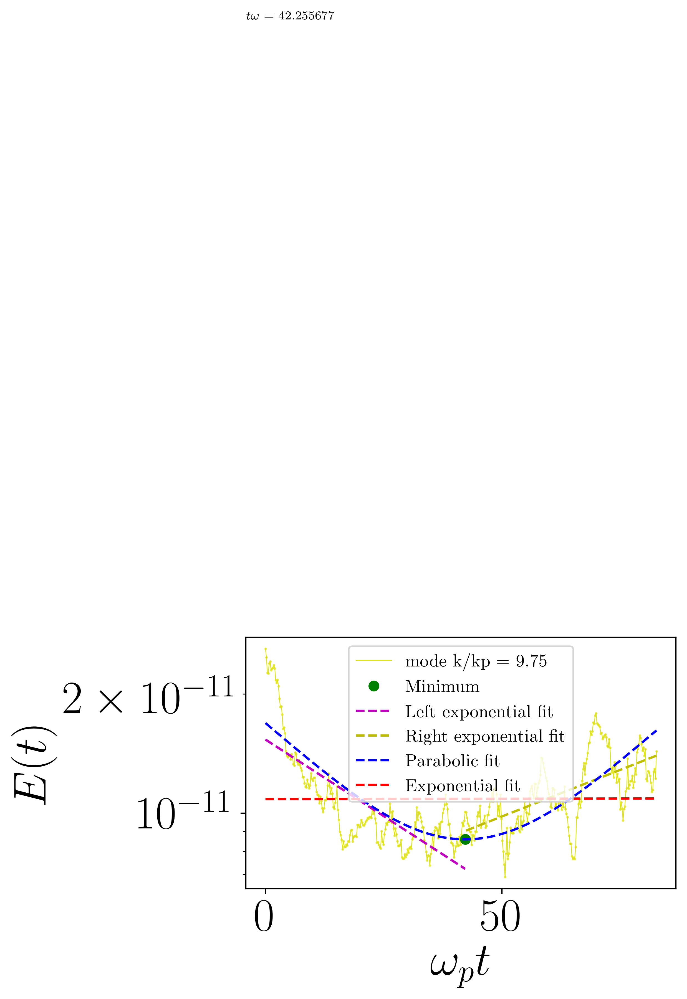

Parabolic fit: k/kp = 9.75,SSE = 2.12e-21, R^2 = 0.53135 time where behaviour changes $\omega t$ 42.2556773875176
RMSE of parabolic fit: 0.00000
a 1.085296736707247e-11 b 4.0852741057421226e-05
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323, 0.007766101691141534, 0.010841068109069948, 0.010351947026819665, 0.011267177019095567, 0.010827323093752679] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0.005592687999048768, -0.

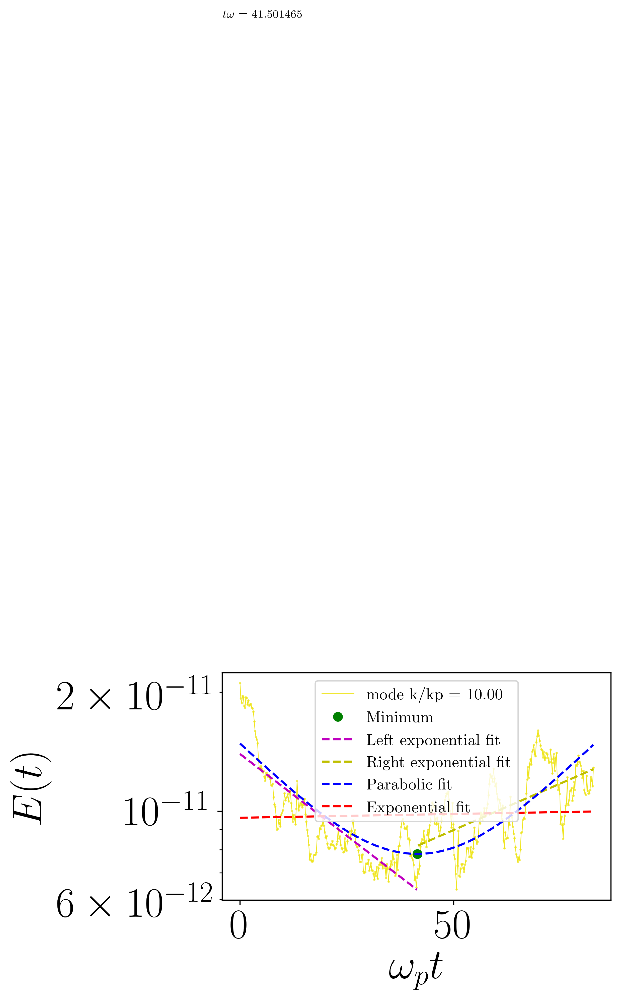

Parabolic fit: k/kp = 10.00,SSE = 1.48e-21, R^2 = 0.55358 time where behaviour changes $\omega t$ 41.50146527244697
RMSE of parabolic fit: 0.00000
a 9.634325032120419e-12 b 0.00044115766805884107
[0.007984140013609, 0.0058777957619892615, 0.006809981743704993, 0.007857778272751444, 0.008361179424601526, 0.008364281810809495, 0.008330395296681878, 0.007998336742381065, 0.006849945165482496, 0.005899153948911346, 0.006588317885510567, 0.005031957556291836, 0.0031063771598783254, 0.0018956879100194737, 0.003600942696383645, 0.000691952568594303, 4.436018428373546e-05, 0.0060908468938745694, 0.006182511055315418, 0.006728401856404522, 0.00992265572661864, 0.006963894308081457, 0.00600773095776048, 0.006567694095504414, 0.004590882667917114, 0.003861343677754323, 0.007766101691141534, 0.010841068109069948, 0.010351947026819665, 0.011267177019095567, 0.010827323093752679, 0.010815656116218746] [-0.00039709801610831013, -0.002930521383472853, -0.0032083697426841425, -0.0002668601733439347, -0

In [289]:
beta_growth = []
beta_decay = []
k_growth = []
k_decay = []

tiempos_minimos = []
kp_minimos = []

sse_values =[]
r2_values =[]

slopes_exp =[]
slopes_exp_decay =[]

for idx, column in enumerate(df_pivot.columns[1:]):
    mode_total_norm = df_pivot[column].values
    # Start a new figure for each mode
    fig, ax = plt.subplots(figsize=[5, 3])
    color = cm.viridis(idx / len(df_pivot.columns[1:]))
    
    
    tiempo = omegap*(time-time[0])
    
    ax.plot(tiempo, mode_total_norm, '-', color=color, lw=0.5, label=f'mode k/kp = {idx/kp:.2f}')
    ax.scatter(tiempo, mode_total_norm, color=color, s=0.5, alpha=0.7)
    
    # Exponential fit
    p = np.polyfit(tiempo, np.log(mode_total_norm), 1)
    a = np.exp(p[1])
    b = p[0]
    y_exponential = a * np.exp(b * tiempo)
    
    slope = b
    
    concavity = "upwards" if b > 0 else "downwards"
    
    # Calculate SSR and R^2 for exponential fit
    residuals_exp = mode_total_norm - y_exponential
    ssr_exp = np.sum(residuals_exp ** 2)
    sst_exp = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2_exp = 1 - (ssr_exp / sst_exp)
    
    if r2_exp > 0.8:
    
        if b>0:
            print('1')
            beta_growth.append(b)
            k_growth.append(idx / kp)
            print(idx / kp)
        else:
            print('2')
            beta_decay.append(b)
            k_decay.append(idx / kp)
            print(idx / kp)
    
    # Append to lists
    sse_values.append(ssr_exp)
    r2_values.append(r2_exp)
    
    # Check if the R^2 value is below the threshold
    if r2_exp < 0.8:
        #print('entra')
        # Perform a parabolic fit
        #print('tiempo', tiempo)
        coefficients_parabola = np.polyfit(tiempo, mode_total_norm, 2)
        y_parabola = np.polyval(coefficients_parabola, tiempo)
        
        a_parabola, b_parabola, c_parabola = coefficients_parabola
        
        concavity = "upwards" if a > 0 else "downwards"
        
        # Para encontrar el punto donde la derivada de la parábola se hace cero, calculamos la derivada y encontramos sus raíces
        # La derivada de la parábola y = ax^2 + bx + c es y' = 2ax + b. El mínimo se encuentra en x = -b/(2a)
        if a != 0:  # Asegurarse de que a no sea cero para evitar la división por cero
            x_minimo = - b_parabola / (2 * a_parabola) 
            print('x minimo',x_minimo)
            y_minimo = np.polyval(coefficients_parabola, x_minimo)
            if (x_minimo>tiempo[0]) & (x_minimo<tiempo[-1]):
                plt.plot(x_minimo, y_minimo, 'go', label='Minimum')
        else:
            x_minimo = None
            y_minimo = None

        concavity = "upwards" if a_parabola > 0 else "downwards"
        
        # Verificar si el punto crítico está dentro del rango de tiempo
        if x_minimo > tiempo[0] and x_minimo < tiempo[-1]:
            # Dividir los datos en intervalos alrededor del punto crítico
            left_mask = tiempo < x_minimo
            right_mask = tiempo > x_minimo
            
            if left_mask.any():
                p_left = np.polyfit(tiempo[left_mask], np.log(mode_total_norm[left_mask]), 1)
                a_left = np.exp(p_left[1])
                b_left = p_left[0]
                y_left_exp = a_left * np.exp(b_left * tiempo[left_mask])
                ax.plot(tiempo[left_mask], y_left_exp, 'm--', label='Left exponential fit')
                if b_left > 0:
                    beta_growth.append(b_left)
                    k_growth.append(idx / kp)
                else:
                    beta_decay.append(b_left)
                    k_decay.append(idx / kp)

            # Para el segmento derecho
            if right_mask.any():
                p_right = np.polyfit(tiempo[right_mask], np.log(mode_total_norm[right_mask]), 1)
                a_right = np.exp(p_right[1])
                b_right = p_right[0]
                y_right_exp = a_right * np.exp(b_right * tiempo[right_mask])

                if b_right > 0:
                    beta_growth.append(b_right)
                    k_growth.append(idx/ kp)
                else:
                    beta_decay.append(b_right)
                    k_decay.append(idx / kp)

                
                ax.plot(tiempo[right_mask], y_right_exp, 'y--', label='Right exponential fit')
        else: #( si xmin no esta en el intervalo tomar el beta del exponencial)
            if b>0:
                print('7')
                beta_growth.append(b)
                k_growth.append(idx / kp)
                print(idx/ kp)
                    
            else:
                print('8')
                beta_decay.append(b)
                k_decay.append(idx/ kp)
                print(idx / kp)
           
        # Calculate residuals for the parabolic fit
        residuals_parabola = mode_total_norm - y_parabola
        rmse = np.sqrt(np.mean(residuals_parabola**2))
        
        ssr_parab= np.sum(residuals_parabola ** 2)
        sst_parab = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
        r2_parab = 1 - (ssr_parab / sst_parab)
        
        # Plot the parabolic fit
        plt.plot(tiempo, y_parabola, 'b--', label='Parabolic fit')
        ax.plot(tiempo, y_exponential, 'r--', label='Exponential fit')
        plt.legend()
        #plt.xscale('log')
        plt.yscale('log')
        plt.xlabel('$\omega_{p} t$')
        plt.ylabel('$E(t)$')
        
        
        x0, xmax = plt.xlim()
        y0, ymax = plt.ylim()
        data_width = xmax - x0
        data_height = ymax - y0
        plt.text(x0 + 0.1, y0+0.000000001, f'$t \omega$ = {x_minimo:2f}')
        
        tiempos_minimos.append(x_minimo)
        kp_minimos.append(idx/kp)
        
        plt.show()
        # Print the results
        print(f'Parabolic fit: k/kp = {idx/kp:.2f},SSE = {ssr_parab:.2e}, R^2 = {r2_parab:.5f}', r'time where behaviour changes $\omega t$', x_minimo )
        print(f'RMSE of parabolic fit: {rmse:.5f}')
        print('a',a,'b',b)

        
    else:
        # Plot the exponential fit
        ax.plot(tiempo, y_exponential, 'r--', label='Exponential fit')
    
    print(beta_growth,beta_decay,k_growth,k_decay)
    
    # Set labels and titles
    ax.set_xlabel('$\omega_{p} t$')
    ax.set_ylabel('$E(t)$')
    ax.set_yscale('log')
    #ax.set_xscale('log')
    ax.legend(fontsize="7")
    ax.grid(True)
    
    # Display the plot
    plt.show()
    
    # Print the exponential fit results
    print(f'Exponential fit: k/kp = {idx/kp:.2f}, slope = {slope:.5f}, SSE = {ssr_exp:.2e}, R^2 = {r2_exp:.5f}')

    if slope < 0:
        slopes_exp_decay.append(slope)
        k_decay.append(idx)
    
    slopes_exp.append(slope)

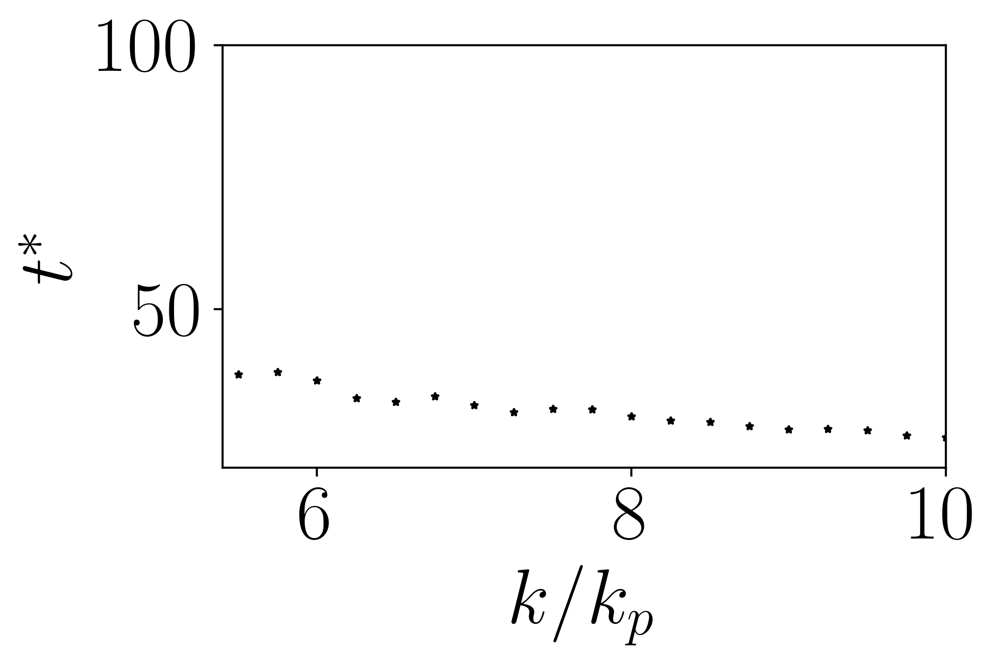

In [79]:
fig = plt.figure(figsize=[5, 3])
plt.scatter(kp_minimos,tiempos_minimos, s =6, marker ="*", color='black')
#plt.axhline(y = 80, color = 'r', linestyle = '--', lw = 0.3) 
#plt.axhline(y = 0, color = 'r', linestyle = '--', lw = 0.3) 
plt.ylabel(r'$t^{*}$')
plt.xlabel(r'$k_x/k_{p}$')
plt.ylim([20,100])
plt.xlim([5.4,10])


# Crear un DataFrame con los datos
df_datos = pd.DataFrame({
    'kp_minimos': kp_minimos,
    'tiempos_minimos': tiempos_minimos
})

# Guardar en CSV
df_datos.to_csv('datos_kpHs016_upc05kx.csv', index=False)

In [295]:
df_beta_kpHs016_upc05 = pd.read_csv('/projects/DEIKE/cmartinb/betas/betas_kpHs016_upc05.csv')

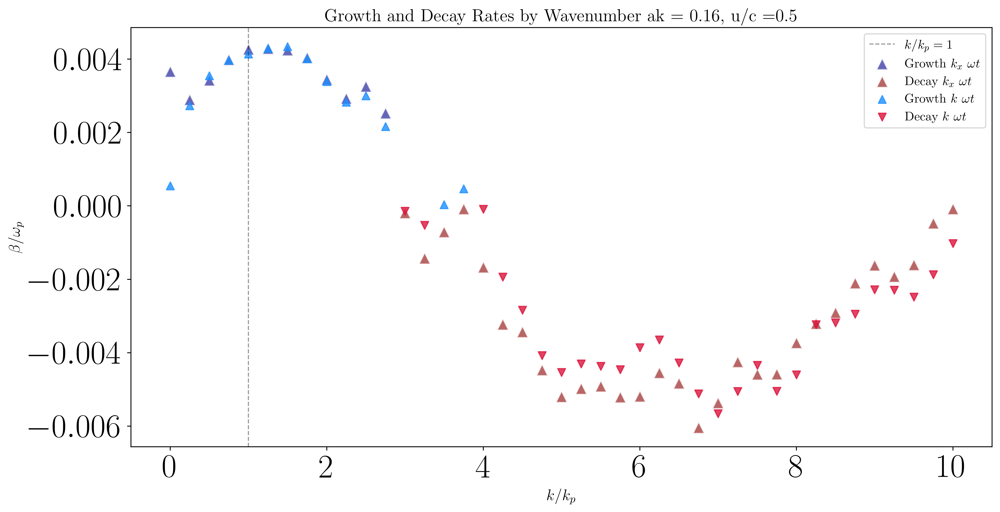

In [296]:
fig, ax = plt.subplots(figsize=(14, 7))
plt.scatter([k/4 for k in k_growth], [beta/omegap for beta in beta_growth], c='darkblue', marker= "^", label=r'Growth $k_x$ $\omega t$', alpha=0.6, edgecolors='w', s=100)
plt.scatter([k/4 for k in k_decay], [beta/omegap for beta in beta_decay], c='darkred', marker= "^", label=r'Decay $k_x$ $\omega t$ ', alpha=0.6, edgecolors='w', s=100)
# Añadir etiquetas y título
plt.xlabel(r'$k/k_p$', fontsize=14)
plt.ylabel(r'$\beta / \omega_{p}$', fontsize=14)
plt.title('Growth and Decay Rates by Wavenumber ak = 0.16, u/c =0.5', fontsize=16)
plt.axvline(x=1, color='k', linestyle='--', linewidth=1, alpha= 0.4,  label=r'$k/k_{p}=1$')

df_beta = df_beta_kpHs016_upc05


df_growth = df_beta[df_beta['Tipo'] == 'Growth']
df_decay = df_beta[df_beta['Tipo'] == 'Decay']
                

# Grafica todos los puntos con el tamaño normal
plt.scatter(df_growth['k']/4, df_growth['Beta']/omegap,alpha=0.8, color='dodgerblue', label=r'Growth $k$ $\omega t$', marker= '^', s=50)
plt.scatter(df_decay['k']/4, df_decay['Beta']/omegap,alpha=0.8, color='crimson',label=r'Decay $k$ $\omega t$', marker='v',  s=50)

# Añadir leyenda
plt.legend()


### 3D spatio-temporal

In [163]:
print(eta_series.shape[0])
data = eta_series
#print(eta_series[4])
kp = 4; omegap = (1*kp)**0.5

422


In [166]:

def spectrum3D_subdivisions(DataEta, time, ln):
    '''
    Compute 3D Fourier Transform in Space and Time over subdivisions of length ln
    in DataEta and calculate different spectra.
    
    DataEta: list with eta (2D) at different times.
    time: vector time associated with this eta.
    ln: length of subdivisions in DataEta.
    '''

    dt = time[1] - time[0]  # Sampling intervals, (s)
    T = time[-1] - time[0]  # Total duration
    
    L0 = 2 * np.pi
    N = 512  # Domain size and grid number in each direction
    
    dx = L0 / N  # Spatial sampling step along X in (m)
    dy = L0 / N  # Spatial sampling step along Y in (m)
    
    # Initialize lists to store spectra for each subdivision
    all_F_xyomega = []
    all_F_kthetaomega = []
    all_F_komega = []
    hann_window = np.hanning(ln)
    #print(dt)
    #F_xyomega = np.zeros((N, len(time), N))
    #F_kthetaomega = np.zeros((len(theta), len(time), len(k)))
    #F_komega = np.zeros((len(k),len(time)))  # Dimension k x omega
    #print('length loop', range(0, len(DataEta), ln))
    overlap_factor = 0.5
    overlap = int(ln * overlap_factor)
    # Process each subdivision of length ln
    for start_idx in range(0,len(DataEta) - overlap, ln - overlap):
        end_idx = start_idx + ln
        #Data_pad = np.pad(DataEta, 1, mode='constant')
        print('interval time idx' ,start_idx, end_idx)
        time_subdivision = np.array(time[start_idx:end_idx])
        print('tw/Tp', omegap*(time_subdivision - time[0])/(2*np.pi))
        data_subdivision = np.array(DataEta[start_idx:end_idx])
        
        if end_idx > len(DataEta):
            # In this case, we can choose to either skip the last window or include it with padding.
            # Let's choose to skip for now.
            break
        
        for i in range(data_subdivision.shape[1]):  # Loop over the second dimension
            for j in range(data_subdivision.shape[2]):  # Loop over the third dimension
                data_subdivision[:, i, j] *= hann_window
        

        dt = time_subdivision[1] - time_subdivision[0]
        
        T = time_subdivision[-1] - time_subdivision[0] 
        x_max = dx * data_subdivision.shape[2]
        y_max = dy * data_subdivision.shape[1]
        
        # Frequencies and wavenumbers for the subdivision
        omega = 2 * np.pi * np.fft.fftshift(np.fft.fftfreq(data_subdivision.shape[0], dt))
        wavenumber = 2 * np.pi * np.fft.fftfreq(N, L0 / N)
        theta = np.linspace(0, 2 * np.pi, N)  # Assuming N points for theta as well
        kx = np.fft.fftshift(wavenumber)
        ky = kx
        k = wavenumber#[0:int(N/2)] #only k>0
        #omega = omega[int(Nt/2):] #only freq>0
        
        spectrum3D = np.fft.fftn(data_subdivision / (N**3))  # FFT normalization for the subdivision
        spectrum3D = np.fft.fftshift(spectrum3D, axes=(0, 1, 2))
        #print('spectrum shape',spectrum3D.shape)
        
        # Compute power spectrum for the subdivision
        dkx = kx[1] - kx[0]
        dky = ky[1] - ky[0]
        domega = omega[1] - omega[0] if len(omega) > 1 else omega[0]  # Handle case with single omega value
        F_3D = (np.absolute(spectrum3D))**2 / (N**2) / ln / (dkx * dky * domega**2)
        #print('intervalo', start_idx, 'F3D' , F_3D.shape)

        kx_tile, ky_tile = np.meshgrid(kx, ky)  # kx-ky space
        k_tile, theta_tile = np.meshgrid(k, theta)  # k-theta space
        kxp_tile, kyp_tile = pol2cart(k_tile, theta_tile)
        Omega, K = np.meshgrid(omega, k) # k-omega space
        
        
        F_xy_interval=[]
        F_komega_interval =[]
        
        for i in range(ln):  # Loop over the frequencies (omega)
            F_xy = F_3D[i]#, 512:,:-512]  # Spectrum F(kx,ky) for each (512,512) in the interval
            print(kx_tile.shape, ky_tile.shape,F_xy.shape, kxp_tile.shape, kyp_tile.shape )
            #F_yomega[:, i, :] = F_xy  # Each column of F_xyomega is a freq
            #F_xyomega[start_idx:start_idx+ln, :, :] = F_3D
            F_ktheta = scipy.interpolate.griddata((kx_tile.ravel(), ky_tile.ravel()), F_xy.ravel(), (kxp_tile, kyp_tile), method='nearest')  # F(omega,kx,ky) --> F(omega,k,theta) for each freq i
            dtheta = theta[1] - theta[0]
            F_komega= np.sum(F_ktheta * k_tile, axis=0) * dtheta  # Integral in theta for each freq i
            
            F_xy_interval.append(F_xy)
            F_komega_interval.append(F_komega)
        
        # Append the spectra for this subdivision
        all_F_xyomega.append(F_xy_interval)
        #all_F_kthetaomega.append(F_ktheta)
        all_F_komega.append(F_komega_interval)
        
        #print('all xy omega', np.array(all_F_xyomega).shape)

    return k , omega,  k_tile, theta_tile, kx, kx_tile, ky_tile , all_F_xyomega, all_F_komega, Omega, K

In [181]:
ln = 150
k , omega,  k_tile, theta_tile, kx,  kx_tile, ky_tile , all_F_xyomega, all_F_komega, omega_tile, K = spectrum3D_subdivisions(data, time, ln)

interval time idx 0 150
tw/Tp [0.         0.03125001 0.06249999 0.09375    0.12500001 0.15624998
 0.18749999 0.21875    0.25000001 0.28124999 0.3125     0.34375001
 0.37499999 0.40625    0.4375     0.46874998 0.49999999 0.53125
 0.56250001 0.59374999 0.625      0.65625001 0.68749998 0.71874999
 0.75       0.78125001 0.81249999 0.84375    0.87500001 0.90624999
 0.9375     0.96875001 0.99999998 1.03124999 1.0625     1.09375001
 1.12499999 1.15625    1.18750001 1.21874999 1.24999999 1.28125
 1.31249998 1.34374999 1.375      1.40625001 1.43749999 1.46875
 1.50000001 1.53124998 1.56249999 1.59375    1.62500001 1.65624999
 1.6875     1.71875001 1.74999999 1.78125    1.8125     1.84374998
 1.87499999 1.90625    1.93750001 1.96874999 2.         2.03125001
 2.06249998 2.09374999 2.125      2.15625001 2.18749999 2.21875
 2.25000001 2.28124999 2.3125     2.34375001 2.37499998 2.40624999
 2.4375     2.46875001 2.49999999 2.53125    2.56250001 2.59374999
 2.625      2.65625    2.68749998 2.71874999

k (41,) omega (38,)
(4, 150, 512) (38, 41)
[22 25 29] -256.0
[22 25 28] -254.99999999999997
[21 25 28] -254.0
[20 24] -252.99999999999997
[20 23 27] -252.0
[20 23 27] -251.0
[19 23 26] -250.0
[19 22 26] -249.0
[18 22 25] -248.0
[18 21] -247.0
[17 21] -246.0
[17 20] -245.0
[16 20] -244.0
[16 19] -243.0
[15 19] -242.0
[15 18] -241.0
[14 18] -240.0
[14 17] -239.0
[14] -238.00000000000003
[13 16] -237.0
[13] -236.00000000000003
[12] -235.0
[12] -234.00000000000003
[11] -233.0
[11] -232.00000000000003
[10] -231.0
[10] -230.00000000000003
[10] -229.0
[9] -228.00000000000003
[9] -227.0
[8] -226.00000000000003
[8] -225.0
[7] -224.00000000000003
[7] -223.0
[6] -222.00000000000003
[6] -221.0
[5] -220.00000000000003
[4] -219.0
[4] -218.00000000000003
[3] -217.0
[] -216.00000000000003


/tmp/ipykernel_1165746/1569601426.py:154: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit * g)
/tmp/ipykernel_1165746/1569601426.py:205: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_second * g)
/tmp/ipykernel_1165746/1569601426.py:219: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_third * g)


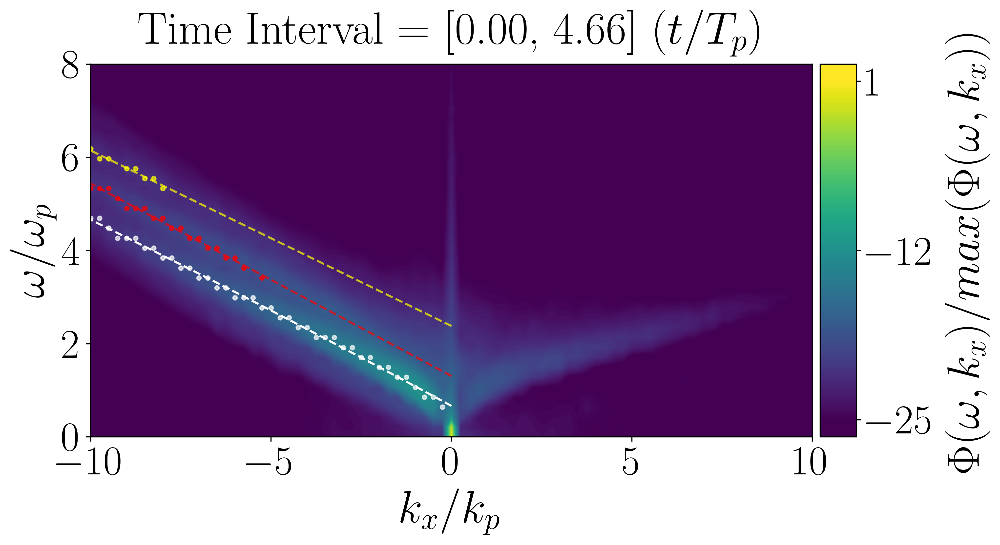

k (41,) omega (38,)
(4, 150, 512) (38, 41)
[23 27 30] -256.0
[23 26 30 33] -254.99999999999997
[23 26 29 32] -254.0
[22 25 28] -252.99999999999997
[22 25 28] -252.0
[21 24 28] -251.0
[20 24 27] -250.0
[20 23 27] -249.0
[19 23 26] -248.0
[19 22] -247.0
[18 22] -246.0
[18 21] -245.0
[17 21] -244.0
[17 20] -243.0
[16 20] -242.0
[16 19] -241.0
[15 19] -240.0
[15 18] -239.0
[14 18] -238.00000000000003
[14 17] -237.0
[13 17] -236.00000000000003
[13 16] -235.0
[12 15] -234.00000000000003
[12] -233.0
[11] -232.00000000000003
[11] -231.0
[10] -230.00000000000003
[10] -229.0
[9] -228.00000000000003
[9] -227.0
[8] -226.00000000000003
[8] -225.0
[7] -224.00000000000003
[7] -223.0
[6] -222.00000000000003
[6] -221.0
[5] -220.00000000000003
[4] -219.0
[4] -218.00000000000003
[3] -217.0
[] -216.00000000000003


/tmp/ipykernel_1165746/1569601426.py:154: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit * g)
/tmp/ipykernel_1165746/1569601426.py:205: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_second * g)
/tmp/ipykernel_1165746/1569601426.py:219: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_third * g)


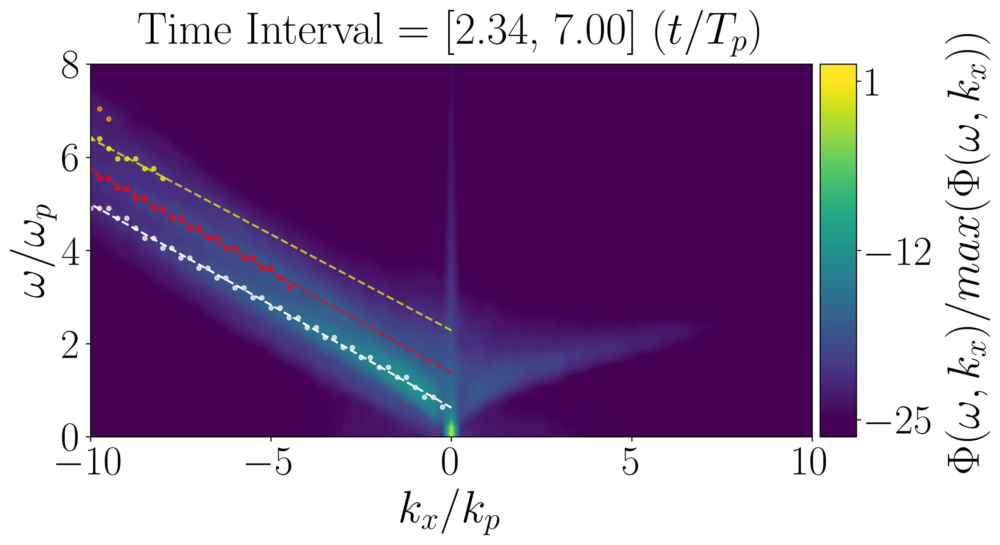

k (41,) omega (38,)
(4, 150, 512) (38, 41)
[25 28 31 34] -256.0
[27 31 33] -254.99999999999997
[24 27 30 33] -254.0
[23 26 30 33] -252.99999999999997
[23 26 29 32] -252.0
[22 25 29] -251.0
[21 25 28] -250.0
[21 24 27] -249.0
[20 23 27] -248.0
[20 23 26] -247.0
[20 23 26] -246.0
[19 22 25] -245.0
[18 21 24] -244.0
[17 21] -243.0
[17 20 23] -242.0
[16 20] -241.0
[16 19] -240.0
[16 19] -239.0
[15 18] -238.00000000000003
[14 18] -237.0
[14 17] -236.00000000000003
[13 16] -235.0
[13 16] -234.00000000000003
[12] -233.0
[12] -232.00000000000003
[11] -231.0
[11] -230.00000000000003
[10] -229.0
[10] -228.00000000000003
[9] -227.0
[8] -226.00000000000003
[8] -225.0
[7] -224.00000000000003
[7] -223.0
[6] -222.00000000000003
[6] -221.0
[5] -220.00000000000003
[4] -219.0
[4] -218.00000000000003
[3] -217.0
[] -216.00000000000003


/tmp/ipykernel_1165746/1569601426.py:154: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit * g)
/tmp/ipykernel_1165746/1569601426.py:205: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_second * g)
/tmp/ipykernel_1165746/1569601426.py:219: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_third * g)


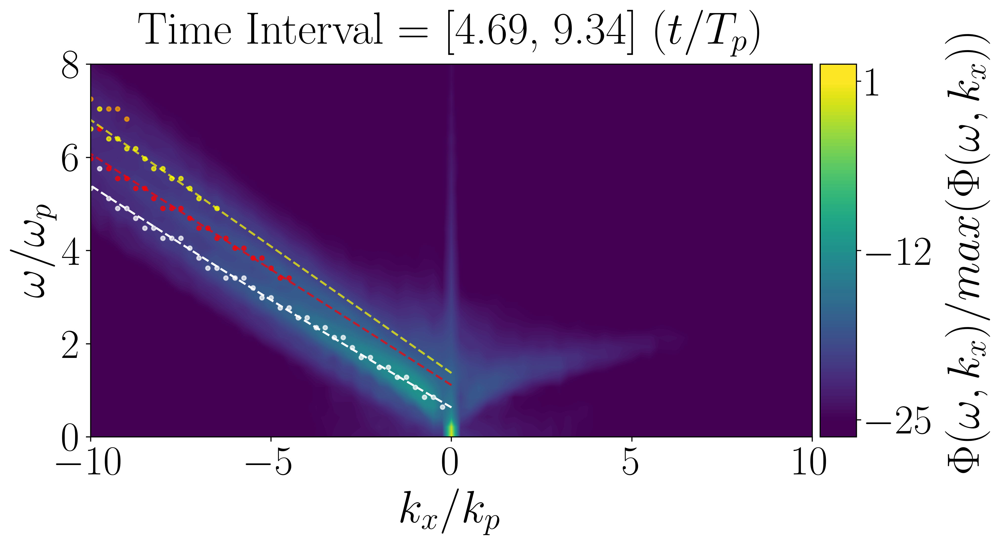

k (41,) omega (38,)
(4, 150, 512) (38, 41)
[26 29 32 35] -256.0
[31] -254.99999999999997
[25 28 31 34] -254.0
[27 30] -252.99999999999997
[27] -252.0
[23 26 29] -251.0
[26 28] -250.0
[25 28 31] -249.0
[21 24 27] -248.0
[20 24 27] -247.0
[23 26] -246.0
[23 26] -245.0
[19 22 25] -244.0
[18 21] -243.0
[18 21 24] -242.0
[17 20] -241.0
[17 20] -240.0
[16 19] -239.0
[15 19] -238.00000000000003
[15 18] -237.0
[15 17] -236.00000000000003
[14 17] -235.0
[13 16] -234.00000000000003
[13 16] -233.0
[12 15] -232.00000000000003
[12 14] -231.0
[11] -230.00000000000003
[10] -229.0
[10] -228.00000000000003
[9] -227.0
[9] -226.00000000000003
[8] -225.0
[8] -224.00000000000003
[7] -223.0
[6] -222.00000000000003
[6] -221.0
[5] -220.00000000000003
[4] -219.0
[4] -218.00000000000003
[3] -217.0
[] -216.00000000000003


/tmp/ipykernel_1165746/1569601426.py:154: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit * g)
/tmp/ipykernel_1165746/1569601426.py:205: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_second * g)
/tmp/ipykernel_1165746/1569601426.py:219: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k_fit_third * g)


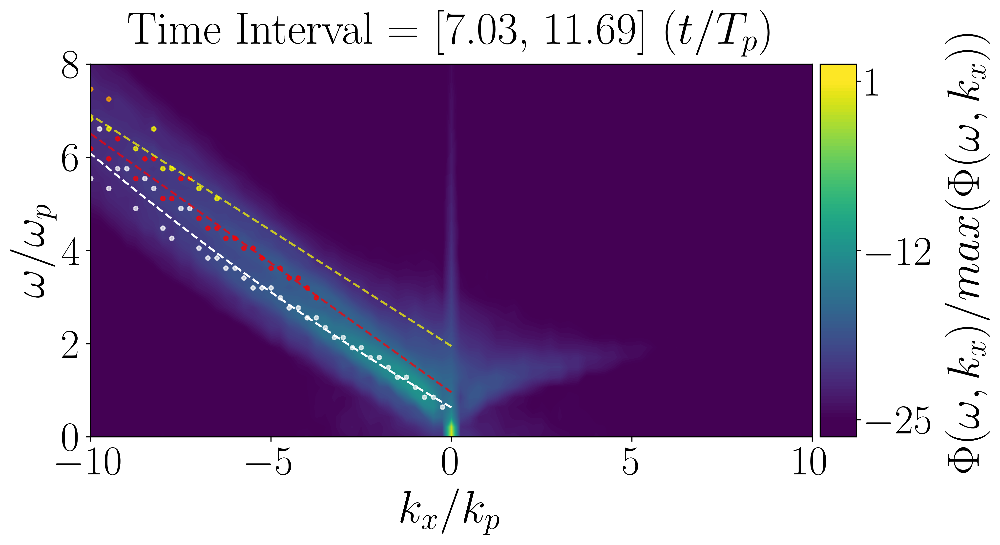

In [253]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.signal import find_peaks
from scipy import stats

# Parámetros de la gráfica
params = {
    'legend.fontsize': 'x-Large',
    'figure.figsize': (14, 6),
    'axes.labelsize': 33,
    'axes.titlesize': 33,
    'xtick.labelsize': 30,
    'ytick.labelsize': 30,
    'font.family': 'STIXGeneral',
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True,
}
plt.rcParams.update(params)

k = kx
all_F_komega = np.mean(all_F_xyomega, axis=2)

# Definición de constantes y parámetros
Re_water = 2.5 * 10**4
c = 1
nu_water = c * 2 * np.pi / (4 * Re_water)
g = 1
omegap = np.sqrt(g * 4)
all_F_komega = np.array(all_F_komega)
overlap_factor = 0.5
overlap = int(ln * overlap_factor)
start_idx = 0

# Definir el rango del cuadrante inicial
k_min = -40
k_max = 0
omega_min = 0
omega_max = 8 * omegap

# Lista para almacenar las diferencias acumuladas y colores
differences_first = []
k_values_first = []
omega_values_first = []
interval_indices_first = []

differences_second = []
k_values_second = []
omega_values_second = []
interval_indices_second = []

differences_third = []
k_values_third = []
omega_values_third = []
interval_indices_third = []

slopes = []
# Procesamiento en cada intervalo
num_intervals = all_F_komega.shape[0]
for i in range(num_intervals):
    fig, ax = plt.subplots(figsize=(10, 5))
    vmin = -25
    vmax = 1
    levels = np.linspace(vmin, vmax, 100)
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    
    norm = np.max(all_F_komega[i, :, :])
    
    # Filtrar los índices dentro del cuadrante
    k_indices = np.where((kx >= k_min) & (kx <= k_max))[0]
    omega_indices = np.where((omega >= omega_min) & (omega <= omega_max))[0]
    
    # Crear la submatriz del cuadrante
    submatrix = all_F_komega[i][omega_indices, :][:, k_indices]
    
    print('k',k_indices.shape,'omega',omega_indices.shape)
    
    print(all_F_komega.shape, submatrix.shape)
    
    im = ax.contourf(kx / 4, omega / omegap, np.log(all_F_komega[i, :] / norm), levels=levels, extend='both')
    
    # Encontrar los picos usando find_peaks en cada columna de la submatriz
    first_peaks_k = []
    second_peaks_k = []
    third_peaks_k = []
    first_peaks_omega = []
    second_peaks_omega = []
    third_peaks_omega = []
    
    colors = ['white', 'red', 'yellow', 'orange']
    for col in range(submatrix.shape[1]):
        column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
        peaks, _ = find_peaks(column_data, distance=2, height=[-1.8, 1])
        k_peakss = kx[k_indices][col] * np.ones(len(omega[omega_indices][peaks]))
        
        print(peaks, kx[col])
        
        for j, peak in enumerate(peaks):
            color = colors[j % len(colors)]  # Asignar un color diferente para cada pico
            ax.scatter(k_peakss[j] / 4, omega[omega_indices][peak] / omegap, color=color, s=9, alpha=0.7)
            
            # Agregar los picos a las listas correspondientes
            if color == 'white':
                first_peaks_k.append(k_peakss[j] / 4)
                first_peaks_omega.append(omega[omega_indices][peak] / omegap)
            elif color == 'red':
                second_peaks_k.append(k_peakss[j] / 4)
                second_peaks_omega.append(omega[omega_indices][peak] / omegap)
            elif color == 'yellow':
                third_peaks_k.append(k_peakss[j] / 4)
                third_peaks_omega.append(omega[omega_indices][peak] / omegap)
    
    # Convertir las listas de picos en arrays para facilitar su manejo
    first_peaks_k = np.array(first_peaks_k)
    first_peaks_omega = np.array(first_peaks_omega)
    
    second_peaks_k = np.array(second_peaks_k)
    second_peaks_omega = np.array(second_peaks_omega)
    
    third_peaks_k = np.array(third_peaks_k)
    third_peaks_omega = np.array(third_peaks_omega)
    
    # Interpolación de los puntos máximos
    k_fit = first_peaks_k
    omega_fit = first_peaks_omega
    
    slope_fit, intercept_fit, r_value_fit, p_value_fit, std_err_fit = stats.linregress(k_fit, omega_fit)
    
    # Interpolación de los puntos de la segunda rama
    k_fit_second = second_peaks_k
    omega_fit_second = second_peaks_omega
    
    slope_second, intercept_second, r_value_second, p_value_second, std_err_second = stats.linregress(k_fit_second, omega_fit_second)
    
    # Interpolación de los puntos de la tercera rama
    k_fit_third = third_peaks_k
    omega_fit_third = third_peaks_omega
    
    slope_third, intercept_third, r_value_third, p_value_third, std_err_third = stats.linregress(k_fit_third, omega_fit_third)
    
    slopes.append([slope_fit, slope_second, slope_third])
    
    if len(k_fit) > 0:  # Asegurarse de que hay puntos válidos para ajustar
        if i < 5:
            # Ajuste cuadrático para los dos primeros intervalos
            p2 = np.polyfit(k_fit, omega_fit, 2)
            fit_line2 = np.polyval(p2, np.linspace(0, -10, 100))
            ax.plot(np.linspace(0, -10, 100), fit_line2, '--', c='w', label='Ajuste Cuadrático')
            
            dispersion_relation = np.sqrt(k_fit * g)
            fit_values = np.polyval(p2, k_fit)
            dispersion_fit_diff = dispersion_relation / omegap - fit_values
            
            # Acumular las diferencias y los valores de k para los primeros intervalos
            differences_first.extend(dispersion_fit_diff)
            k_values_first.extend(k_fit)
            omega_values_first.extend(fit_values)
            interval_indices_first.extend([i] * len(dispersion_fit_diff))  # Asignar el índice del intervalo a los puntos acumulados
        else:
            # Ajuste cúbico y lineal para los dos últimos intervalos
            p3 = np.polyfit(k_fit, omega_fit, 3)
            inflexion_points = find_inflexion_point_cubic(p3)
            inflexion_point = inflexion_points[0]  # Tomar el primer punto de inflexión encontrado

            # Particionar los datos en dos ramas
            left_branch = k_fit <= inflexion_point
            right_branch = k_fit > inflexion_point
            
            # Ajuste lineal para la rama derecha
            if np.sum(right_branch) > 1:  # Asegurarse de que hay suficientes puntos para ajustar
                p1 = np.polyfit(k_fit[right_branch], omega_fit[right_branch], 1)
                fit_line1 = np.polyval(p1, np.linspace(inflexion_point, -10, 100))
                ax.plot(np.linspace(inflexion_point, -10, 100), fit_line1, '--', c='w', label='Ajuste Lineal', alpha=0.7)
                
                inflexion_omega = np.polyval(p3, inflexion_point)
                ax.scatter(inflexion_point, inflexion_omega, marker='*', s=20, c='white', zorder=5, label='Punto de Inflexión')

                # Ajuste cúbico para la rama izquierda
                fit_line3 = np.polyval(p3, np.linspace(0, inflexion_point, 100))
                ax.plot(np.linspace(0, inflexion_point, 100), fit_line3, '--', c='w', label='Ajuste Cúbico')
                
                # Calcular la diferencia entre la relación de dispersión y el ajuste
                dispersion_relation = np.sqrt(k_fit * g)
                fit_values = np.concatenate((np.polyval(p3, k_fit[left_branch]), np.polyval(p1, k_fit[right_branch])))
                dispersion_fit_diff = dispersion_relation / omegap - fit_values
                
                # Acumular las diferencias y los valores de k para los últimos intervalos
                differences_first.extend(dispersion_fit_diff)
                k_values_first.extend(k_fit)
                omega_values_first.extend(fit_values)
                interval_indices_first.extend([i] * len(dispersion_fit_diff))  # Asignar el índice del intervalo a los puntos acumulados

    # Ajuste para los puntos de la segunda rama
    if len(k_fit_second) > 0:
        p_red = np.polyfit(k_fit_second, omega_fit_second, 1)
        fit_line_red = np.polyval(p_red, np.linspace(0, -10, 100))
        ax.plot(np.linspace(0, -10, 100), fit_line_red, '--', c='r', label='Ajuste Rojo', alpha=0.7)
        # Calcular la diferencia entre la relación de dispersión y el ajuste de la segunda rama
        fit_values_second = np.polyval(p_red, k_fit_second)
        
        dispersion_relation = np.sqrt(k_fit_second * g)
        dispersion_fit_diff_second = dispersion_relation / omegap - np.polyval(p_red, k_fit_second)
        
        differences_second.extend(dispersion_fit_diff_second)
        k_values_second.extend(k_fit_second)
        omega_values_second.extend(fit_values_second)
        interval_indices_second.extend([i] * len(dispersion_fit_diff_second))  # Asignar el índice del intervalo a los puntos acumulados

    if len(k_fit_third) > 0:
        p_yellow = np.polyfit(k_fit_third, omega_fit_third, 1)
        fit_line_yellow = np.polyval(p_yellow, np.linspace(0, -10, 100))
        ax.plot(np.linspace(0, -10, 100), fit_line_yellow, '--', c='yellow', label='Ajuste Amarillo', alpha=0.7)
        fit_values_third = np.polyval(p_yellow, k_fit_third)
        
        dispersion_relation = np.sqrt(k_fit_third * g)
        dispersion_fit_diff_third = dispersion_relation / omegap - np.polyval(p_yellow, k_fit_third)
        
        differences_third.extend(dispersion_fit_diff_third)
        k_values_third.extend(k_fit_third)
        omega_values_third.extend(fit_values_third)
        interval_indices_third.extend([i] * len(dispersion_fit_diff_third))  # Asignar el índice del intervalo a los puntos acumulados
    
    plt.xlim([-10, 10])
    plt.ylim([0, 8])
    plt.ylabel(r'$\omega/\omega_{p}$')
    plt.xlabel(r'$k_x/k_{p}$')

    ax.set_title(f'Time Interval = [{(time_subdivision[0] - time[0]) * omegap / (2 * np.pi):.2f}, '
                 f'{(time_subdivision[-1] - time[0]) * omegap / (2 * np.pi):.2f}] $(t/T_{{p}})$', pad=15)

    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.08)
    cbar = fig.colorbar(im, cax=cax, orientation='vertical', extendrect='False', ticks=[vmin, (vmin + vmax) / 2, vmax])
    cbar.set_label(r'$\Phi(\omega,k_x)/max(\Phi(\omega,k_x))$', labelpad=7)
    plt.show()
    
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break


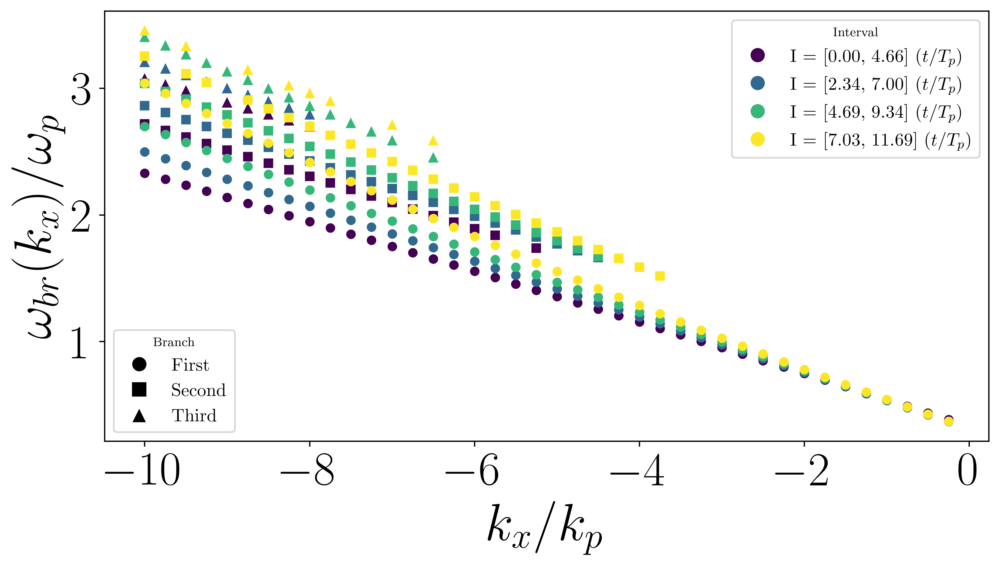

In [235]:
import numpy as np
import matplotlib.pyplot as plt

# Supuestos: 'k_values_first', 'differences_first', 'k_values_second', 'differences_second', 'k_values_third', 'differences_third',
# 'interval_indices_first', 'interval_indices_second', 'interval_indices_third', 'time', 'ln', 'overlap', 'omegap' ya están definidos
num_intervals = all_F_komega.shape[0]

# Factores de normalización para cada rama
normalization_factors = [np.sqrt(1), np.sqrt(1), np.sqrt(1)]

interval_indices_first = np.array(interval_indices_first, dtype=int)
interval_indices_second = np.array(interval_indices_second, dtype=int)
interval_indices_third = np.array(interval_indices_third, dtype=int)

# Verifica que las longitudes coincidan
assert len(k_values_first) == len(differences_first) == len(interval_indices_first) == len(omega_values_first), "Las longitudes de k_values_first, differences_first e interval_indices_first no coinciden"
assert len(k_values_second) == len(differences_second) == len(interval_indices_second) == len(omega_values_second), "Las longitudes de k_values_second, differences_second e interval_indices_second no coinciden"
assert len(k_values_third) == len(differences_third) == len(interval_indices_third) == len(omega_values_third), "Las longitudes de k_values_third, differences_third e interval_indices_third no coinciden"

# Normalizar las diferencias para cada conjunto
normalized_omega_first = np.abs(np.array(omega_values_first)) / normalization_factors[0]
normalized_omega_second = np.abs(np.array(omega_values_second)) / normalization_factors[1]
normalized_omega_third = np.abs(np.array(omega_values_third)) / normalization_factors[2]

normalized_differences_first = np.abs(np.array(differences_first)) / normalization_factors[0]
normalized_differences_second = np.abs(np.array(differences_second)) / normalization_factors[1]
normalized_differences_third = np.abs(np.array(differences_third)) / normalization_factors[2]

# Definir símbolos para cada conjunto
symbols = ['o', 's', '^']
labels = ['First', 'Second', 'Third']

# Plot de la diferencia acumulada para todos los intervalos
fig, ax = plt.subplots(figsize=(10, 5))
# Colores para cada intervalo usando la paleta viridis
interval_colors = plt.cm.viridis(np.linspace(0, 1, num_intervals))
start_idx = 0

interval_ranges = []
for i in range(num_intervals):
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    interval_ranges.append(f'I = [{(time_subdivision[0] - time[0]) * omegap / (2 * np.pi):.2f}, {(time_subdivision[-1] - time[0]) * omegap / (2 * np.pi):.2f}] $(t/T_{{p}})$')
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break

start_idx = 0
# Graficar los puntos con colores diferentes según el intervalo
for i in range(num_intervals):
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    
    idx_first = interval_indices_first == i
    idx_second = interval_indices_second == i
    idx_third = interval_indices_third == i
    
    
    if np.any(idx_first):
        k_first = np.array(k_values_first)[idx_first]
        ax.plot(k_first, (normalized_omega_first[idx_first]) / omegap, symbols[0], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "")
    
    if np.any(idx_second):
        k_second = np.array(k_values_second)[idx_second]
        ax.plot(k_second, (normalized_omega_second[idx_second]) / omegap, symbols[1], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "")
    
    if np.any(idx_third):
        k_third = np.array(k_values_third)[idx_third]
        ax.plot(k_third, (normalized_omega_third[idx_third]) / omegap, symbols[2], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "")
    
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break

# Añadir la relación de dispersión teórica para el agua
#k_diss = np.linspace(0, 40)
#dispersion_relation = np.sqrt(k_diss * g)
#ax.plot(k_diss / 4, dispersion_relation / omegap, ':', lw=0.5, c='black', label=r"$\omega= \sqrt{gk}$")

ax.set_xlabel(r'$k_x/k_{p}$')
ax.set_ylabel(r'$  \omega_{br}(k_x)/\omega_{p}$')

# Crear leyendas separadas para las ramas y los intervalos
first_legend = ax.legend([plt.Line2D([0], [0], marker=s, color='w', markerfacecolor='black', markersize=10) for s in symbols], labels, loc='lower left', title='Branch')
ax.add_artist(first_legend)

# Utiliza los rangos de intervalos originales en la leyenda
unique_handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=interval_colors[i], markersize=10) for i in range(num_intervals)]
ax.legend(unique_handles, interval_ranges, loc='upper right', title='Interval')

plt.show()

In [236]:
data_dict = {
    'k_values_first': k_values_first,
    'differences_first': differences_first,
    'omega_values_first': omega_values_first,
    'interval_indices_first': interval_indices_first.tolist(),
    'normalized_omega_first': normalized_omega_first.tolist(),
    'normalized_differences_first': normalized_differences_first.tolist(),
    
    'k_values_second': k_values_second,
    'differences_second': differences_second,
    'omega_values_second': omega_values_second,
    'interval_indices_second': interval_indices_second.tolist(),
    'normalized_omega_second': normalized_omega_second.tolist(),
    'normalized_differences_second': normalized_differences_second.tolist(),
    
    'k_values_third': k_values_third,
    'differences_third': differences_third,
    'omega_values_third': omega_values_third,
    'interval_indices_third': interval_indices_third.tolist(),
    'normalized_omega_third': normalized_omega_third.tolist(),
    'normalized_differences_third': normalized_differences_third.tolist(),
    
    'interval_ranges': interval_ranges,
    'symbols': symbols,
    'labels': labels,
    'time': time.tolist(),
    'ln': ln,
    'overlap': overlap,
    'omegap': omegap
}


In [239]:
import json

# Guardar el diccionario en un archivo JSON
with open('/projects/DEIKE/cmartinb/omegas/ak016_uc05_kx.json', 'w') as f:
    json.dump(data_dict, f)

# Cargar el diccionario desde el archivo JSON
with open('/projects/DEIKE/cmartinb/omegas/ak016_uc05_kx.json', 'r') as f:
    loaded_data_dict = json.load(f)


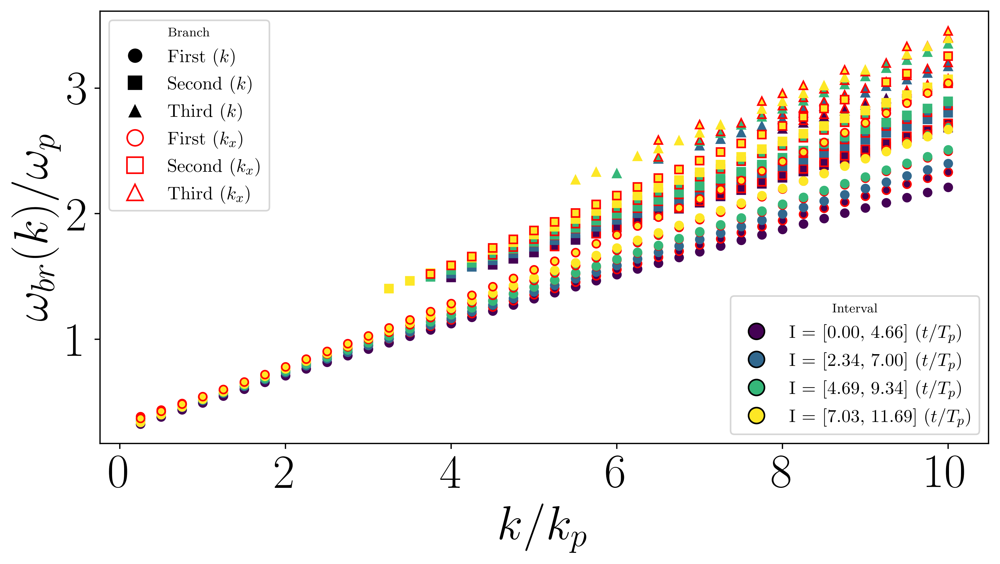

In [307]:
import json
import numpy as np
import matplotlib.pyplot as plt

# Cargar el primer diccionario desde el archivo JSON
with open('/projects/DEIKE/cmartinb/omegas/ak016_uc05.json', 'r') as f:
    loaded_data_dict = json.load(f)

# Cargar el segundo diccionario desde el archivo JSON
with open('/projects/DEIKE/cmartinb/omegas/ak016_uc05_kx.json', 'r') as f:
    loaded_data_dict_kx = json.load(f)

# Convertir listas de vuelta a arrays de numpy si es necesario para el primer diccionario
k_values_first = np.array(loaded_data_dict['k_values_first'])
differences_first = np.array(loaded_data_dict['differences_first'])
omega_values_first = np.array(loaded_data_dict['omega_values_first'])
interval_indices_first = np.array(loaded_data_dict['interval_indices_first'], dtype=int)
normalized_omega_first = np.array(loaded_data_dict['normalized_omega_first'])
normalized_differences_first = np.array(loaded_data_dict['normalized_differences_first'])

k_values_second = np.array(loaded_data_dict['k_values_second'])
differences_second = np.array(loaded_data_dict['differences_second'])
omega_values_second = np.array(loaded_data_dict['omega_values_second'])
interval_indices_second = np.array(loaded_data_dict['interval_indices_second'], dtype=int)
normalized_omega_second = np.array(loaded_data_dict['normalized_omega_second'])
normalized_differences_second = np.array(loaded_data_dict['normalized_differences_second'])

k_values_third = np.array(loaded_data_dict['k_values_third'])
differences_third = np.array(loaded_data_dict['differences_third'])
omega_values_third = np.array(loaded_data_dict['omega_values_third'])
interval_indices_third = np.array(loaded_data_dict['interval_indices_third'], dtype=int)
normalized_omega_third = np.array(loaded_data_dict['normalized_omega_third'])
normalized_differences_third = np.array(loaded_data_dict['normalized_differences_third'])

interval_ranges = loaded_data_dict['interval_ranges']
symbols = loaded_data_dict['symbols']
labels = loaded_data_dict['labels']
time = np.array(loaded_data_dict['time'])

ln = loaded_data_dict['ln']
overlap = loaded_data_dict['overlap']
omegap = loaded_data_dict['omegap']

# Convertir listas de vuelta a arrays de numpy si es necesario para el segundo diccionario
k_values_first_kx = np.array(loaded_data_dict_kx['k_values_first'])
differences_first_kx = np.array(loaded_data_dict_kx['differences_first'])
omega_values_first_kx = np.array(loaded_data_dict_kx['omega_values_first'])
interval_indices_first_kx = np.array(loaded_data_dict_kx['interval_indices_first'], dtype=int)
normalized_omega_first_kx = np.array(loaded_data_dict_kx['normalized_omega_first'])
normalized_differences_first_kx = np.array(loaded_data_dict_kx['normalized_differences_first'])

k_values_second_kx = np.array(loaded_data_dict_kx['k_values_second'])
differences_second_kx = np.array(loaded_data_dict_kx['differences_second'])
omega_values_second_kx = np.array(loaded_data_dict_kx['omega_values_second'])
interval_indices_second_kx = np.array(loaded_data_dict_kx['interval_indices_second'], dtype=int)
normalized_omega_second_kx = np.array(loaded_data_dict_kx['normalized_omega_second'])
normalized_differences_second_kx = np.array(loaded_data_dict_kx['normalized_differences_second'])

k_values_third_kx = np.array(loaded_data_dict_kx['k_values_third'])
differences_third_kx = np.array(loaded_data_dict_kx['differences_third'])
omega_values_third_kx = np.array(loaded_data_dict_kx['omega_values_third'])
interval_indices_third_kx = np.array(loaded_data_dict_kx['interval_indices_third'], dtype=int)
normalized_omega_third_kx = np.array(loaded_data_dict_kx['normalized_omega_third'])
normalized_differences_third_kx = np.array(loaded_data_dict_kx['normalized_differences_third'])

interval_ranges_kx = loaded_data_dict_kx['interval_ranges']
symbols_kx = loaded_data_dict_kx['symbols']
labels_kx = loaded_data_dict_kx['labels']
time_kx = np.array(loaded_data_dict_kx['time'])

ln_kx = loaded_data_dict_kx['ln']
overlap_kx = loaded_data_dict_kx['overlap']
omegap_kx = loaded_data_dict_kx['omegap']

# Número de intervalos
num_intervals = len(interval_ranges)

# Graficar los datos cargados
fig, ax = plt.subplots(figsize=(10, 5))

# Colores para cada intervalo usando la paleta viridis
interval_colors = plt.cm.viridis(np.linspace(0, 1, num_intervals))

# Graficar los puntos con colores diferentes según el intervalo
start_idx = 0
for i in range(num_intervals):
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    
    idx_first = interval_indices_first == i
    idx_second = interval_indices_second == i
    idx_third = interval_indices_third == i
    
    idx_first_kx = interval_indices_first_kx == i
    idx_second_kx = interval_indices_second_kx == i
    idx_third_kx = interval_indices_third_kx == i
    
    if np.any(idx_first):
        k_first = k_values_first[idx_first]
        ax.plot(k_first, (normalized_omega_first[idx_first]) / omegap, symbols[0], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "")
    
    if np.any(idx_second):
        k_second = k_values_second[idx_second]
        ax.plot(k_second, (normalized_omega_second[idx_second]) / omegap, symbols[1], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "")
    
    if np.any(idx_third):
        k_third = k_values_third[idx_third]
        ax.plot(k_third, (normalized_omega_third[idx_third]) / omegap, symbols[2], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "")
    
    if np.any(idx_first_kx):
        k_first_kx = k_values_first_kx[idx_first_kx]
        ax.plot(np.abs(k_first_kx), (normalized_omega_first_kx[idx_first_kx]) / omegap_kx, symbols[0], markersize=5, color=interval_colors[i], markeredgecolor='red', label=interval_ranges_kx[i] if i == 0 else "")
    
    if np.any(idx_second_kx):
        k_second_kx = k_values_second_kx[idx_second_kx]
        ax.plot(np.abs(k_second_kx), (normalized_omega_second_kx[idx_second_kx]) / omegap_kx, symbols[1], markersize=5, color=interval_colors[i], markeredgecolor='red', label=interval_ranges_kx[i] if i == 0 else "")
    
    if np.any(idx_third_kx):
        k_third_kx = k_values_third_kx[idx_third_kx]
        ax.plot(np.abs(k_third_kx), (normalized_omega_third_kx[idx_third_kx]) / omegap_kx, symbols[2], markersize=5, color=interval_colors[i], markeredgecolor='red', label=interval_ranges_kx[i] if i == 0 else "")
    
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break

ax.set_xlabel(r'$k/k_p$')
ax.set_ylabel(r'$  \omega_{br}(k)/\omega_{p}$')
#plt.yscale('log')

# Crear leyendas separadas para las ramas y los intervalos
first_legend = ax.legend(
    [plt.Line2D([0], [0], marker=s, color='w', markerfacecolor='black', markersize=10) for s in symbols] + 
    [plt.Line2D([0], [0], marker=s, color='w', markerfacecolor='none', markersize=10, markeredgecolor='red') for s in symbols], 
    [label + ' $(k)$' for label in labels] + [label + ' $(k_x)$' for label in labels], 
    loc='upper left', title='Branch'
)
ax.add_artist(first_legend)

unique_handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=interval_colors[i], markersize=10, markeredgecolor='k') for i in range(num_intervals)]
ax.legend(unique_handles, interval_ranges, loc='lower right', title='Interval')

plt.show()


(4, 512)
(4, 512)
